In [1]:
from sqlite3 import SQLITE_CREATE_VIEW
import anndata
import scanpy as sc
import os
from bbknn import bbknn
import matplotlib.pyplot as plt
import omicverse as ov
import scvi
import scib
from scvi.model.utils import mde
from scib_metrics.benchmark import Benchmarker
import scanorama
import numpy as np
import pyliger
from harmony import harmonize
from rich import print
import seaborn as sns
import bbknn
import doubletdetection
%matplotlib inline
plt.rcParams.update({'font.size': 12})


   ____            _     _    __                  
  / __ \____ ___  (_)___| |  / /__  _____________ 
 / / / / __ `__ \/ / ___/ | / / _ \/ ___/ ___/ _ \ 
/ /_/ / / / / / / / /__ | |/ /  __/ /  (__  )  __/ 
\____/_/ /_/ /_/_/\___/ |___/\___/_/  /____/\___/                                              

Version: 1.5.3, Tutorials: https://omicverse.readthedocs.io/


Global seed set to 0
/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/umap/plot.py:203: NumbaDeprecationWarning: The keyword argument 'nopython=False' was supplied. From Numba 0.59.0 the default is being changed to True and use of 'nopython=False' will raise a warning as the argument will have no effect. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.


In [2]:
#####Change path and Load data
os.chdir("/mnt/disk5/Lanxiang/Human_integrated/integrated/10.29_update")
human_data = anndata.read_h5ad("human_reanno_clean.h5ad")
monkey_data = anndata.read_h5ad("monkey_reanno_clean.h5ad")

In [3]:
human_data

AnnData object with n_obs × n_vars = 33406 × 60421
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'CCA_res_0.5_colors', 'FastMNN_res_0.5_colors', 'Harmony_res_0.5_colors', 'LIGER_res_0.5_colors', 'Scanorama_res_0.5_colors', 'Unintegrated_res_0.5_colors', 'anno_colors', 'dendrogram_lineage', 'dendrogram_reanno', 'harmo.anno_colors', 'hvg', 'leiden', 'leiden_3_colors', 'lineage_colors', 'log1p', 'neighbors', 'orig.ident_colors', 'pca', 'r

In [4]:
monkey_data

AnnData object with n_obs × n_vars = 141868 × 44223
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'CCA_res_0.5_colors', 'FastMNN_res_0.5_colors', 'Harmony_res_0.5_colors', 'LIGER_res_0.5_colors', 'Scanorama_res_0.5_colors', 'Unintegrated_res_0.5_colors', 'anno_colors', 'harmo.anno_colors', 'hvg', 'leiden', 'leiden_3_colors', 'lineage_colors', 'log1p', 'neighbors', 'orig.ident_colors', 'pca', 'reanno_colors', 'scANVI_res_0.5_colors', 's

In [5]:
print(human_data.X)

(0, 4)        0.0855016865466988
  (0, 10)       0.0855016865466988
  (0, 12)       0.16426518125366685
  (0, 20)       0.5896574616062754
  (0, 22)       0.0855016865466988
  (0, 25)       0.36902031975322847
  (0, 26)       0.5896574616062754
  (0, 28)       0.16426518125366685
  (0, 31)       0.3053158743576146
  (0, 39)       0.5896574616062754
  (0, 40)       0.16426518125366685
  (0, 43)       0.8107913523998501
  (0, 46)       0.16426518125366685
  (0, 47)       0.42890841421185777
  (0, 48)       0.42890841421185777
  (0, 53)       0.0855016865466988
  (0, 54)       1.7765590110647602
  (0, 55)       0.23727538121151837
  (0, 56)       0.16426518125366685
  (0, 57)       1.394995284765954
  (0, 63)       0.5388923546781661
  (0, 65)       0.5896574616062754
  (0, 66)       0.3053158743576146
  (0, 68)       1.394995284765954
  (0, 75)       0.36902031975322847
  :     :
  (33405, 54555)        1.234323601549568
  (33405, 54602)        1.234323601549568
  (33405, 54741)        1.5377443379944717
  (33405, 54995)        0.7966179702751798
  (33405, 55690)        0.7966179702751798
  (33405, 55793)        0.7966179702751798
  (33405, 55885)        0.7966179702751798
  (33405, 56090)        3.881626580858971
  (33405, 56246)        0.7966179702751798
  (33405, 56289)        0.7966179702751798
  (33405, 56587)        0.7966179702751798
  (33405, 56664)        1.234323601549568
  (33405, 56864)        0.7966179702751798
  (33405, 56957)        0.7966179702751798
  (33405, 57063)        1.7702135449531942
  (33405, 57510)        1.234323601549568
  (33405, 57591)        0.7966179702751798
  (33405, 57708)        1.5377443379944717
  (33405, 57788)        0.7966179702751798
  (33405, 57953)        0.7966179702751798
  (33405, 57958)        0.7966179702751798
  (33405, 58802)        0.7966179702751798
  (33405, 58833)        0.7966179702751798
  (33405, 60398)        4.105668751422434
  (33405, 60400)        4.849486303022313

In [6]:
print(human_data.layers["counts"])

(0, 4)        1.0
  (0, 10)       1.0
  (0, 12)       2.0
  (0, 20)       9.0
  (0, 22)       1.0
  (0, 25)       5.0
  (0, 26)       9.0
  (0, 28)       2.0
  (0, 31)       4.0
  (0, 39)       9.0
  (0, 40)       2.0
  (0, 43)       14.0
  (0, 46)       2.0
  (0, 47)       6.0
  (0, 48)       6.0
  (0, 53)       1.0
  (0, 54)       55.0
  (0, 55)       3.0
  (0, 56)       2.0
  (0, 57)       34.0
  (0, 63)       8.0
  (0, 65)       9.0
  (0, 66)       4.0
  (0, 68)       34.0
  (0, 75)       5.0
  :     :
  (33405, 54555)        2.0
  (33405, 54602)        2.0
  (33405, 54741)        3.0
  (33405, 54995)        1.0
  (33405, 55690)        1.0
  (33405, 55793)        1.0
  (33405, 55885)        1.0
  (33405, 56090)        39.0
  (33405, 56246)        1.0
  (33405, 56289)        1.0
  (33405, 56587)        1.0
  (33405, 56664)        2.0
  (33405, 56864)        1.0
  (33405, 56957)        1.0
  (33405, 57063)        4.0
  (33405, 57510)        2.0
  (33405, 57591)        1.0
  (33405, 57708)        3.0
  (33405, 57788)        1.0
  (33405, 57953)        1.0
  (33405, 57958)        1.0
  (33405, 58802)        1.0
  (33405, 58833)        1.0
  (33405, 60398)        49.0
  (33405, 60400)        104.0

In [7]:
print(monkey_data.X)

(0, 0)        0.09902216991949327
  (0, 2)        0.11240073131723025
  (0, 3)        0.29417007283029883
  (0, 26)       0.07171618449144299
  (0, 38)       0.6533380038455169
  (0, 39)       0.12560178521633533
  (0, 41)       0.05777858679785444
  (0, 42)       0.029306531003170905
  (0, 43)       0.05777858679785444
  (0, 44)       0.029306531003170905
  (0, 46)       0.5473317547409999
  (0, 48)       0.23717358098989363
  (0, 49)       0.05777858679785444
  (0, 51)       0.16419217515535536
  (0, 52)       0.4190082407622221
  (0, 54)       0.18911638108598647
  (0, 57)       0.8430468258438795
  (0, 58)       0.0854622846038706
  (0, 59)       1.3946347150954845
  (0, 63)       1.0861524408812142
  (0, 64)       0.6533380038455169
  (0, 67)       0.637742711005587
  (0, 72)       0.04364388772310328
  (0, 74)       0.5473317547409999
  (0, 76)       0.4667507618634803
  :     :
  (141867, 43787)       1.1725290866934812
  (141867, 43790)       0.7490906629932456
  (141867, 43794)       0.7490906629932456
  (141867, 43828)       0.7490906629932456
  (141867, 43895)       0.7490906629932456
  (141867, 43903)       1.6975043377789099
  (141867, 43938)       0.7490906629932456
  (141867, 43962)       0.7490906629932456
  (141867, 43972)       0.7490906629932456
  (141867, 43984)       0.7490906629932456
  (141867, 44019)       0.7490906629932456
  (141867, 44020)       1.883332238117129
  (141867, 44038)       3.844131858920729
  (141867, 44042)       1.1725290866934812
  (141867, 44045)       1.1725290866934812
  (141867, 44051)       0.7490906629932456
  (141867, 44070)       1.1725290866934812
  (141867, 44073)       0.7490906629932456
  (141867, 44089)       0.7490906629932456
  (141867, 44139)       0.7490906629932456
  (141867, 44143)       2.8100688320096023
  (141867, 44153)       1.1725290866934812
  (141867, 44184)       0.7490906629932456
  (141867, 44186)       0.7490906629932456
  (141867, 44211)       1.1725290866934812

In [8]:
print(monkey_data.layers["counts"])

(0, 0)        10.4088
  (0, 2)        11.8958
  (0, 3)        34.2003
  (0, 26)       7.43484
  (0, 38)       92.1921
  (0, 39)       13.3827
  (0, 41)       5.94788
  (0, 42)       2.97394
  (0, 43)       5.94788
  (0, 44)       2.97394
  (0, 46)       72.8615
  (0, 48)       26.7654
  (0, 49)       5.94788
  (0, 51)       17.8436
  (0, 52)       52.0439
  (0, 54)       20.8176
  (0, 57)       132.34
  (0, 58)       8.92181
  (0, 59)       303.342
  (0, 63)       196.28
  (0, 64)       92.1921
  (0, 67)       89.2181
  (0, 72)       4.46091
  (0, 74)       72.8615
  (0, 76)       59.4788
  :     :
  (141867, 43787)       2.0
  (141867, 43790)       1.0
  (141867, 43794)       1.0
  (141867, 43828)       1.0
  (141867, 43895)       1.0
  (141867, 43903)       4.0
  (141867, 43938)       1.0
  (141867, 43962)       1.0
  (141867, 43972)       1.0
  (141867, 43984)       1.0
  (141867, 44019)       1.0
  (141867, 44020)       5.0
  (141867, 44038)       41.0
  (141867, 44042)       2.0
  (141867, 44045)       2.0
  (141867, 44051)       1.0
  (141867, 44070)       2.0
  (141867, 44073)       1.0
  (141867, 44089)       1.0
  (141867, 44139)       1.0
  (141867, 44143)       14.0
  (141867, 44153)       2.0
  (141867, 44184)       1.0
  (141867, 44186)       1.0
  (141867, 44211)       2.0

In [9]:
set(human_data.obs["lineage"])

{'Endoderm',
 'ExE_endo',
 'Exe_meso',
 'Gastru',
 'Notochord',
 'PGC',
 'TE_TrB',
 'epi',
 'hemogenic',
 'mesoderm',
 'neural_ecto',
 'non_neuro_ecto'}

In [10]:
set(monkey_data.obs["lineage"])

{'Endoderm',
 'ExE_endo',
 'Exe_meso',
 'Gastru',
 'Notochord',
 'PGC',
 'TE_TrB',
 'epi',
 'hemogenic',
 'mesoderm',
 'neural_ecto',
 'non_neuro_ecto'}

In [11]:
adata_combined = sc.concat([human_data, monkey_data], join='outer', axis=0)

In [12]:
adata_combined

AnnData object with n_obs × n_vars = 175274 × 86368
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    layers: 'counts', 'logcounts'

In [13]:
# R interface
from rpy2.robjects import pandas2ri
from rpy2.robjects import r
import rpy2.rinterface_lib.callbacks
import anndata2ri

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

In [14]:
%%R
# R packages
library(Seurat)


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

Loading required package: SeuratObject
Loading required package: sp

Attaching package: ‘SeuratObject’

The following object is masked from ‘package:base’:

    intersect

In addition: Warning message:
In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages


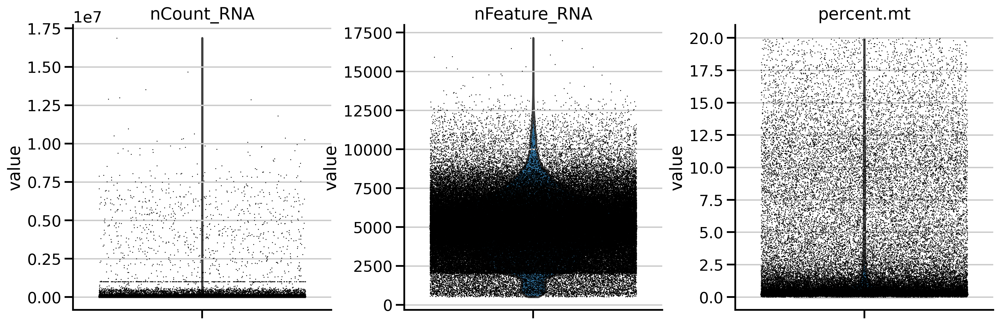

In [15]:
sc.pl.violin(
    adata_combined,
    ["nCount_RNA", "nFeature_RNA", "percent.mt"],
    jitter=0.4,
    multi_panel=True)

In [16]:
# remove "empty" genes
sc.pp.filter_genes(adata_combined, min_cells=1)

In [17]:
adata_combined

AnnData object with n_obs × n_vars = 175274 × 84580
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation'
    var: 'n_cells'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    layers: 'counts', 'logcounts'

In [18]:
adata_combined.X = adata_combined.layers["counts"].copy()

In [19]:
#clf = doubletdetection.BoostClassifier(
#    n_iters=40,
#   clustering_algorithm="louvain",
#    standard_scaling=True,
#    pseudocount=0.1,
#    n_jobs=-1,
#)
#doublets = clf.fit(adata_combined.X).predict(p_thresh=1e-16, voter_thresh=0.5)
#doublet_score = clf.doublet_score()

In [20]:
#adata_combined.obs["doublet"] = doublets
#adata_combined.obs["doublet_score"] = doublet_score

In [21]:
sc.settings.seed = 42
sc.pp.normalize_total(adata_combined, target_sum=1e4)
sc.pp.log1p(adata_combined)
adata_combined.layers["logcounts"] = adata_combined.X.copy()
sc.pp.highly_variable_genes(adata_combined, n_top_genes=2000, flavor="cell_ranger", batch_key="orig.ident")
sc.tl.pca(adata_combined, n_comps=30, use_highly_variable=True)

In [22]:
adata_combined

AnnData object with n_obs × n_vars = 175274 × 84580
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [23]:
adata = adata_combined.copy()

In [24]:
adata_hvg = adata[:, adata.var.highly_variable].copy()

In [25]:
adata_hvg

AnnData object with n_obs × n_vars = 175274 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [26]:
os.chdir("/mnt/disk5/Lanxiang/Human_integrated/integrated/10.29_update/fig")

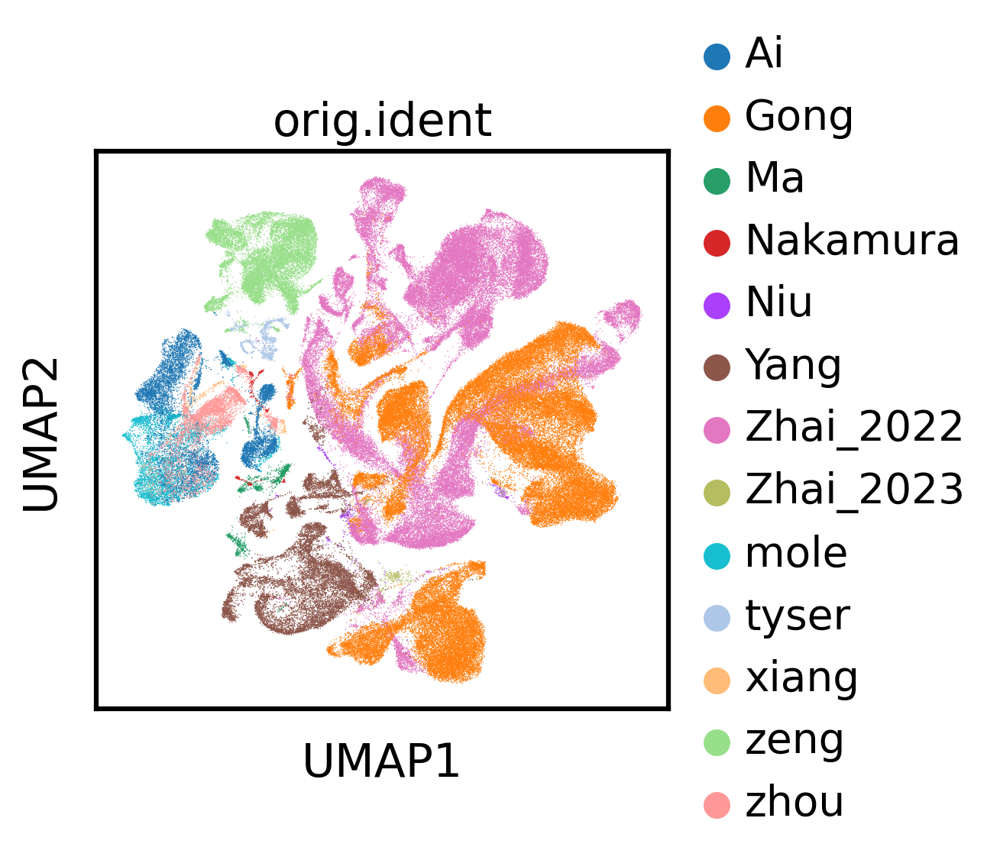

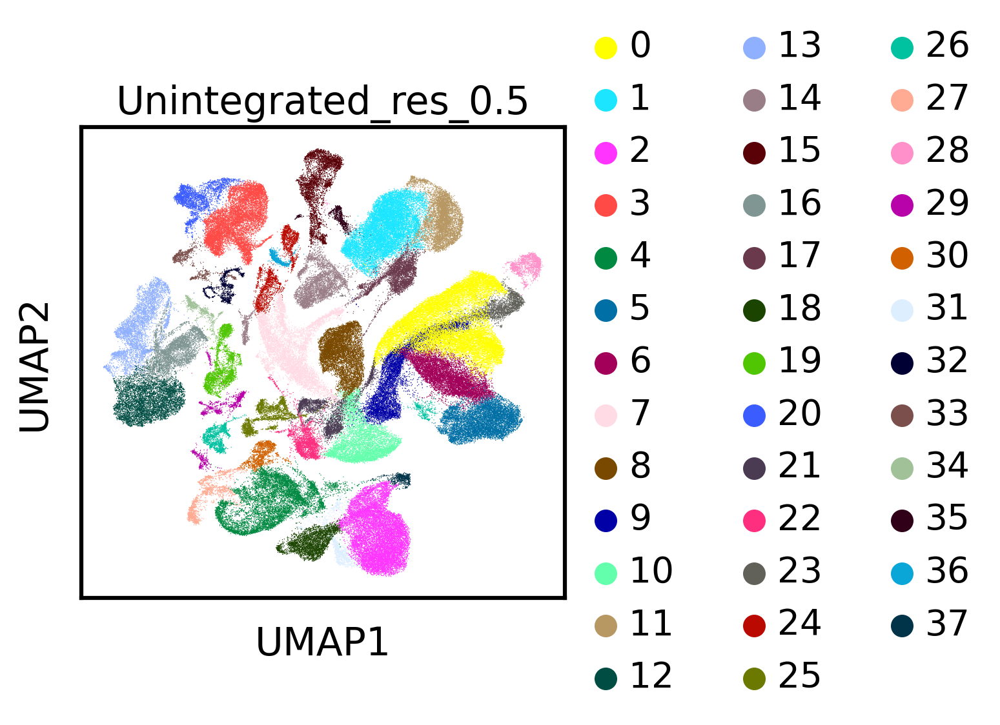

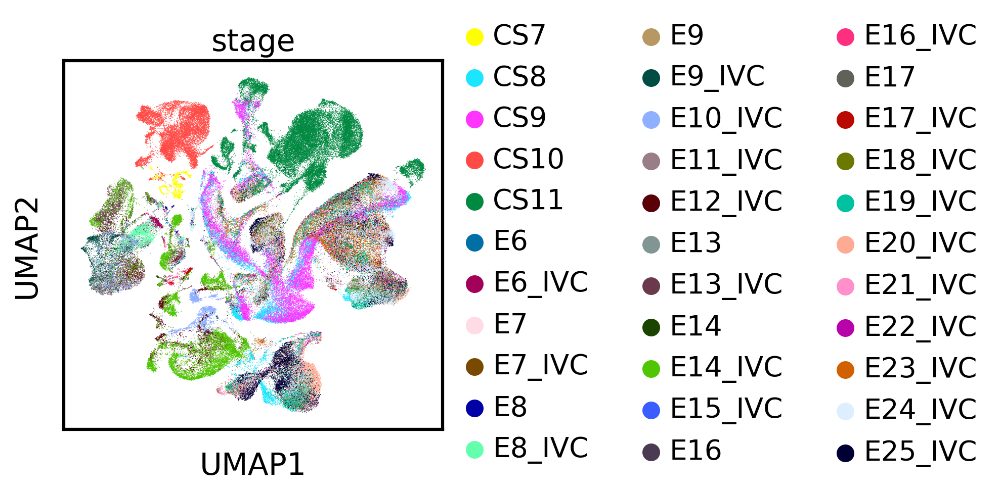

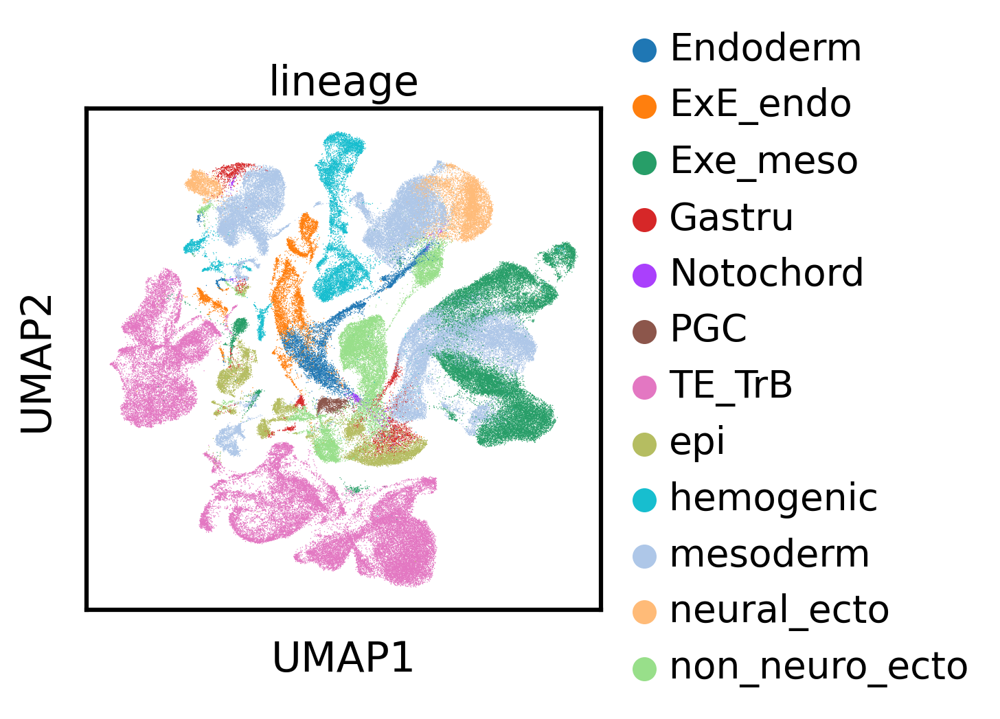

In [27]:
####Unintegrated
adata.obsm["Unintegrated"] = adata_hvg.obsm["X_pca"]
adata_hvg.obsm["Unintegrated"] = adata_hvg.obsm["X_pca"]
sc.pp.neighbors(adata, use_rep="Unintegrated",random_state=42)
sc.tl.leiden(adata, resolution=0.5,key_added=f"Unintegrated_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_Unintegrated'] = adata.obsm['X_umap']
sc.pl.umap(adata, color=['orig.ident'], save="Unintegrated_orig_ident.pdf")
sc.pl.umap(adata, color=['Unintegrated_res_0.5'], save="Unintegrated_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'], save="Unintegrated_stage.pdf")
sc.pl.umap(adata, color=['lineage'], save="Unintegrated_lineage.pdf")

In [28]:
###Scanorama
import scanorama
batch_cats = adata_hvg.obs['orig.ident'].cat.categories
adata_list = [adata_hvg[adata_hvg.obs['orig.ident'] == b].copy() for b in batch_cats]
scanorama.integrate_scanpy(adata_list)

adata.obsm["Scanorama"] = np.zeros((adata_hvg.shape[0], adata_list[0].obsm["X_scanorama"].shape[1]))
for i, b in enumerate(batch_cats):
    adata.obsm["Scanorama"][adata_hvg.obs['orig.ident'] == b] = adata_list[i].obsm["X_scanorama"]

Found 2000 genes among all datasets
[[0.00000000e+00 1.61421438e-02 1.41221374e-01 0.00000000e+00
  0.00000000e+00 1.16130531e-04 3.48391592e-04 0.00000000e+00
  5.61383285e-01 1.27986348e-02 7.97665370e-02 1.17291836e-02
  1.16714015e-01]
 [0.00000000e+00 0.00000000e+00 1.83206107e-02 0.00000000e+00
  2.96370968e-01 1.71022467e-01 2.82910208e-01 2.35099338e-01
  0.00000000e+00 5.97269625e-03 0.00000000e+00 8.04093567e-04
  0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 6.45833333e-01
  3.42741935e-02 1.29770992e-01 8.39694656e-03 3.31125828e-03
  0.00000000e+00 7.67918089e-03 0.00000000e+00 7.63358779e-04
  0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  2.11309524e-01 2.67857143e-02 2.97619048e-03 1.32450331e-02
  0.00000000e+00 0.00000000e+00 2.38095238e-01 0.00000000e+00
  2.73809524e-01]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 5.02016129e-01 1.41129032e-01 3.17880795e-01
  0.00000000e+00 5.04032

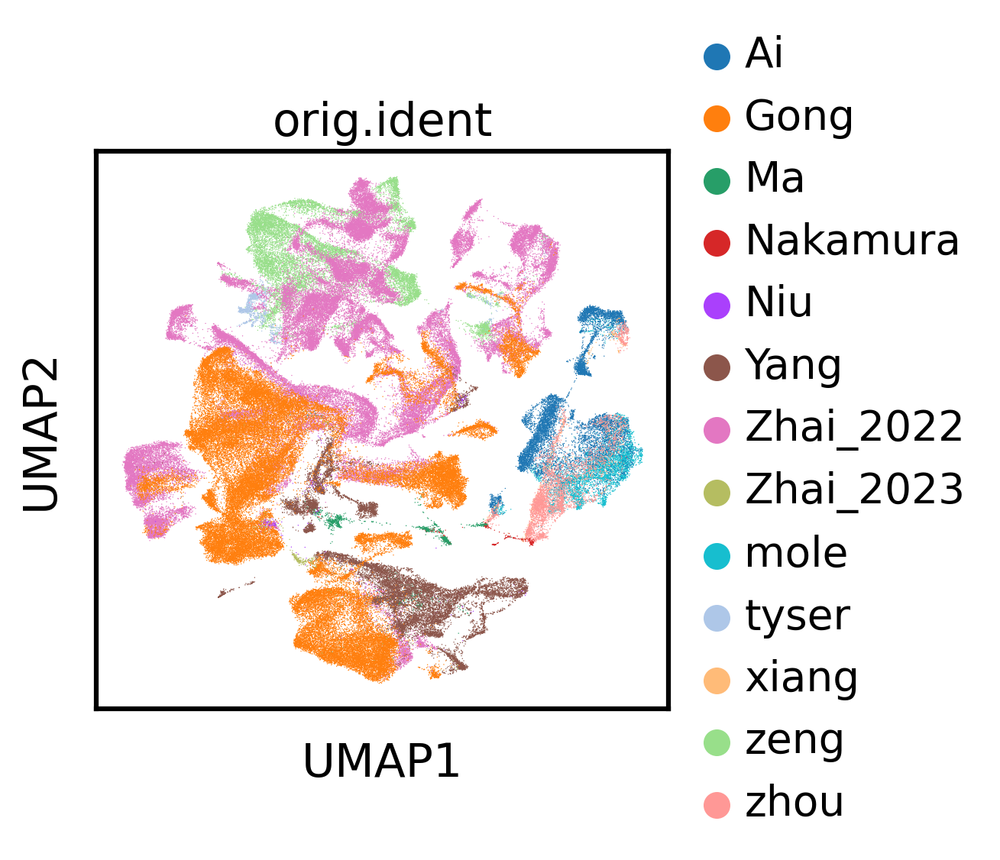

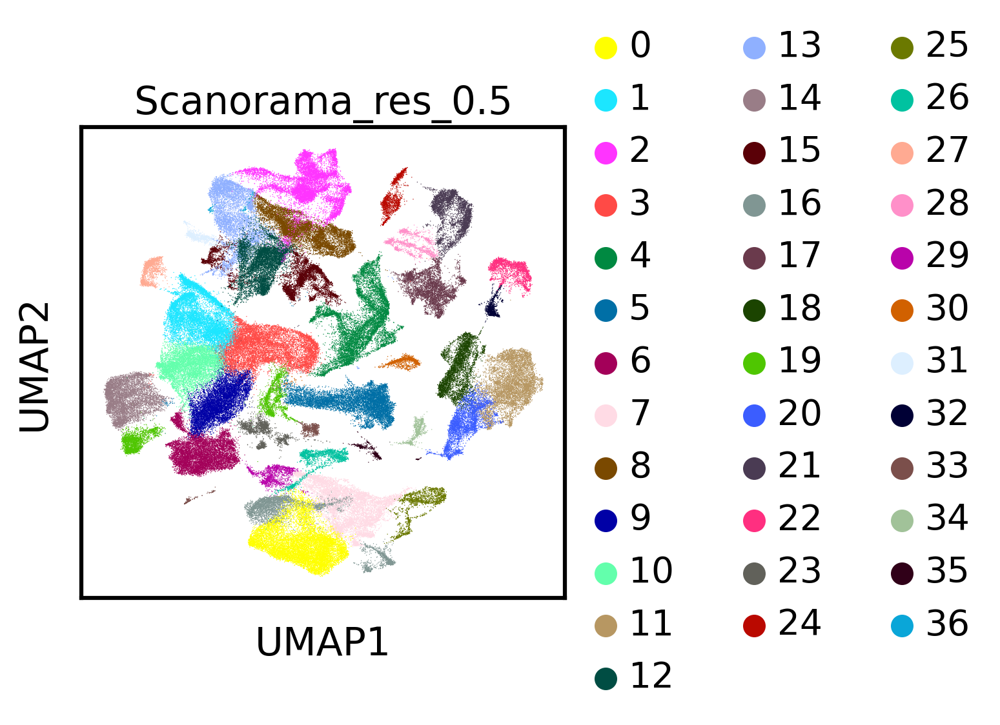

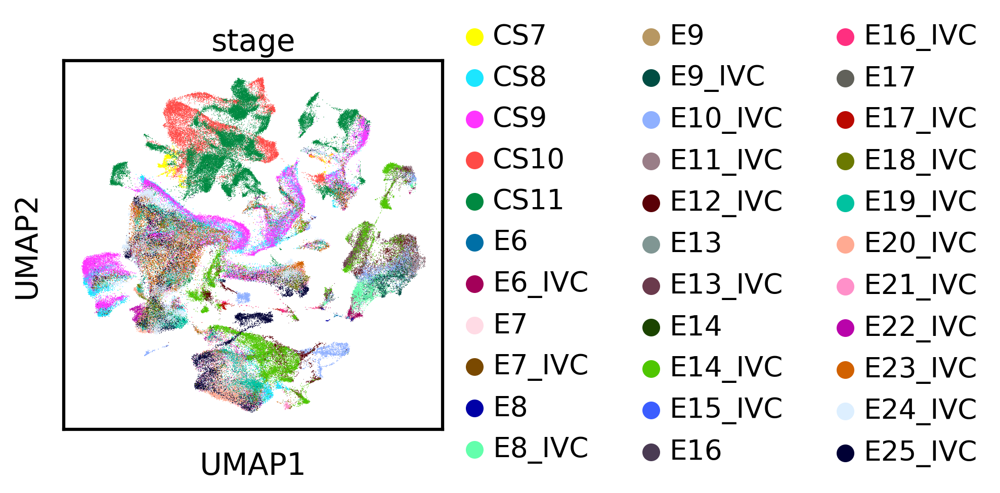

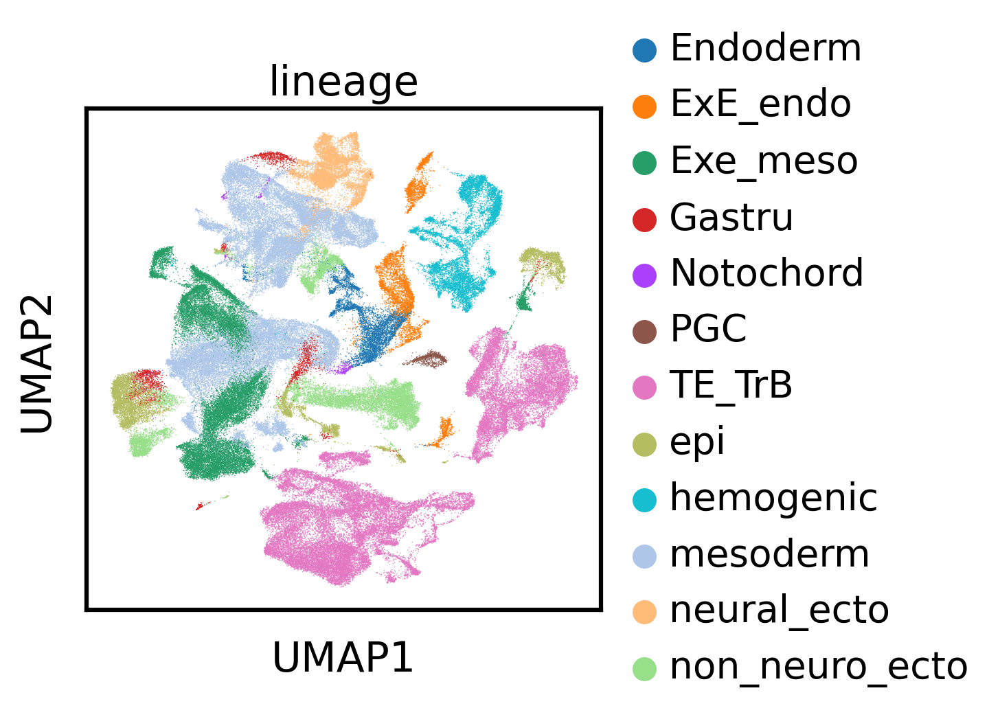

In [29]:
adata_hvg.obsm["Scanorama"] = adata.obsm["Scanorama"]
sc.pp.neighbors(adata, use_rep="Scanorama",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"Scanorama_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_Scanorama'] = adata.obsm['X_umap']
adata_hvg.obsm['X_Scanorama'] = adata.obsm['X_umap']
sc.pl.umap(adata, color=['orig.ident'], save="Scanorama_orig_ident.pdf")
sc.pl.umap(adata, color=['Scanorama_res_0.5'], save="Scanorama_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'], save="Scanorama_stage.pdf")
sc.pl.umap(adata, color=['lineage'], save="Scanorama_lineage.pdf")

In [30]:
####Liger
bdata = adata_hvg.copy()
# Pyliger normalizes by library size with a size factor of 1
# So here we give it the count data
bdata.X = bdata.layers["counts"]
# List of adata per batch
adata_list = [bdata[bdata.obs['orig.ident'] == b].copy() for b in batch_cats]
for i, ad in enumerate(adata_list):
    ad.uns["sample_name"] = batch_cats[i]
    # Hack to make sure each method uses the same genes
    ad.uns["var_gene_idx"] = np.arange(bdata.n_vars)

liger_data = pyliger.create_liger(adata_list, remove_missing=False, make_sparse=False)
# Hack to make sure each method uses the same genes
liger_data.var_genes = bdata.var_names
pyliger.normalize(liger_data)
pyliger.scale_not_center(liger_data)
pyliger.optimize_ALS(liger_data, k=30)
pyliger.quantile_norm(liger_data)

adata.obsm["LIGER"] = np.zeros((adata_hvg.shape[0], liger_data.adata_list[0].obsm["H_norm"].shape[1]))
for i, b in enumerate(batch_cats):
    adata.obsm["LIGER"][adata_hvg.obs['orig.ident'] == b] = liger_data.adata_list[i].obsm["H_norm"]

/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/pyliger/preprocessing/_scale.py:88: RuntimeWarning: divide by zero encountered in divide
100%|███████████████████████████████████████████████████████████████████████████████████████| 30/30 [20:32<00:00, 41.09s/it]


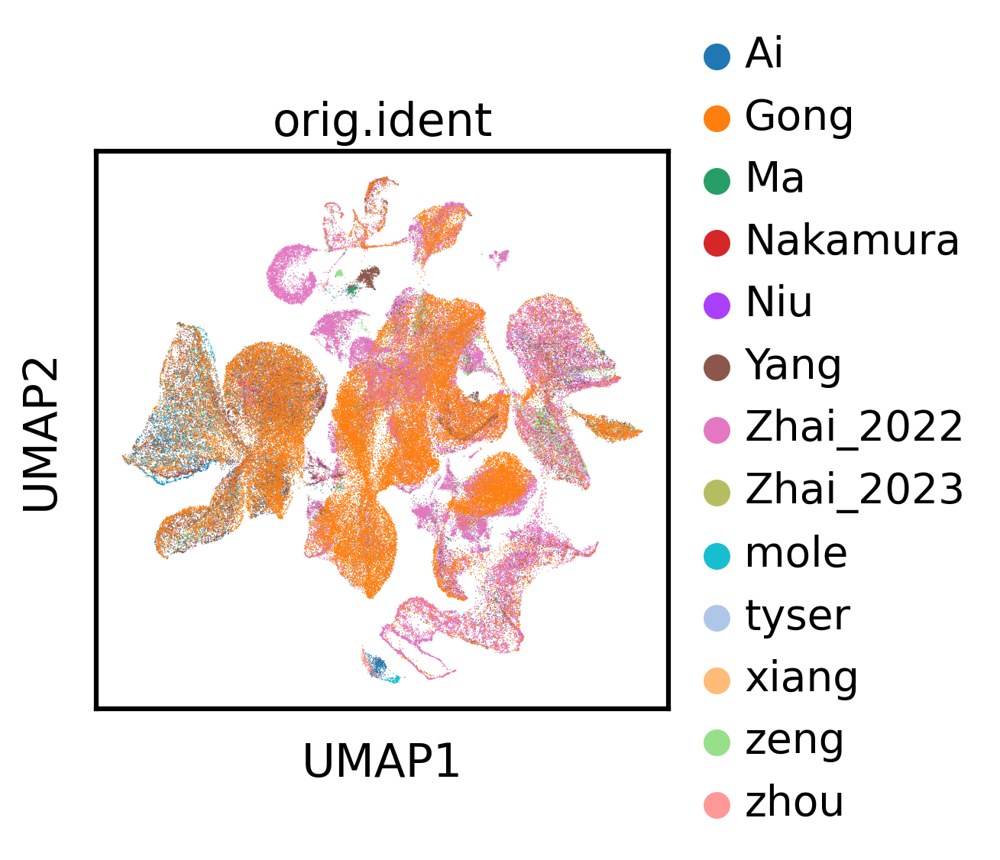

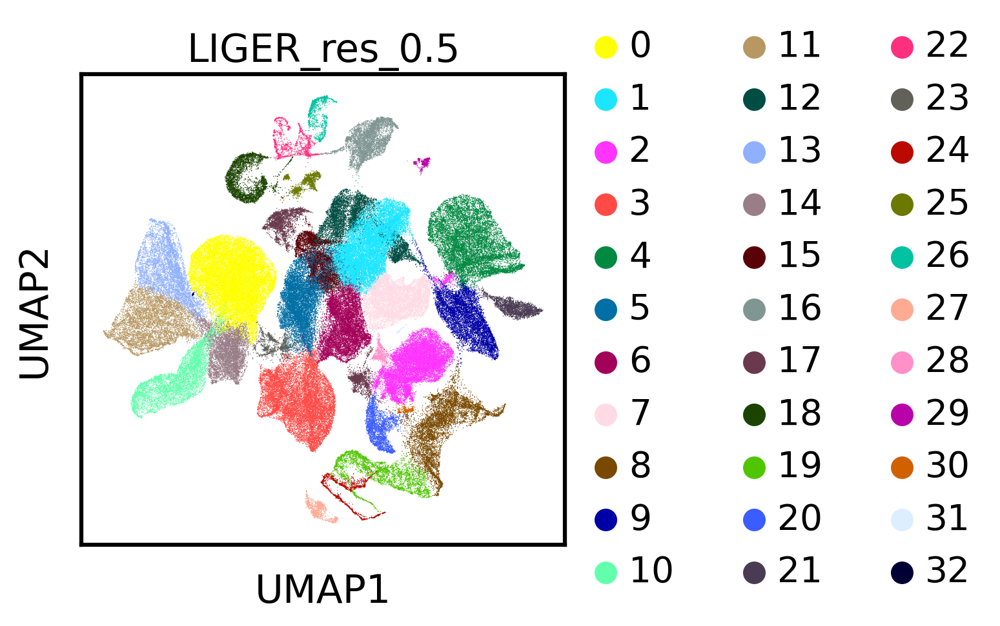

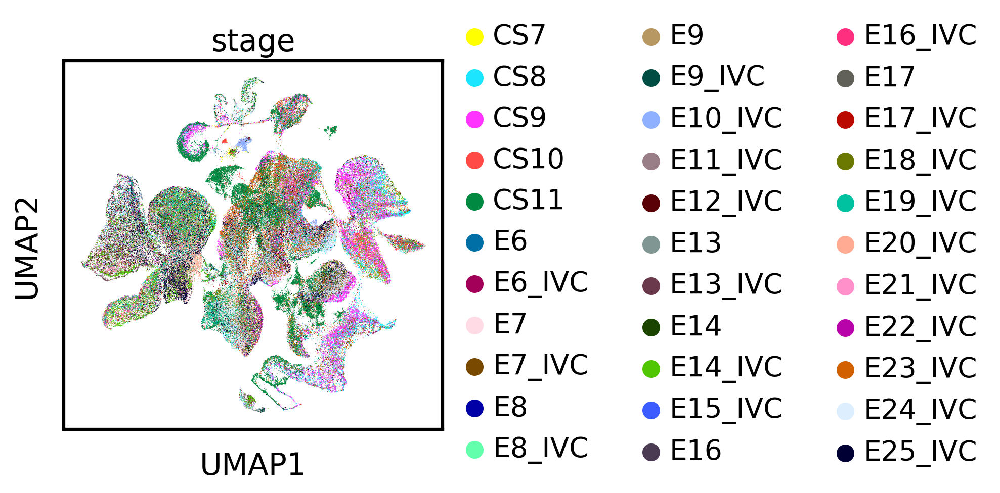

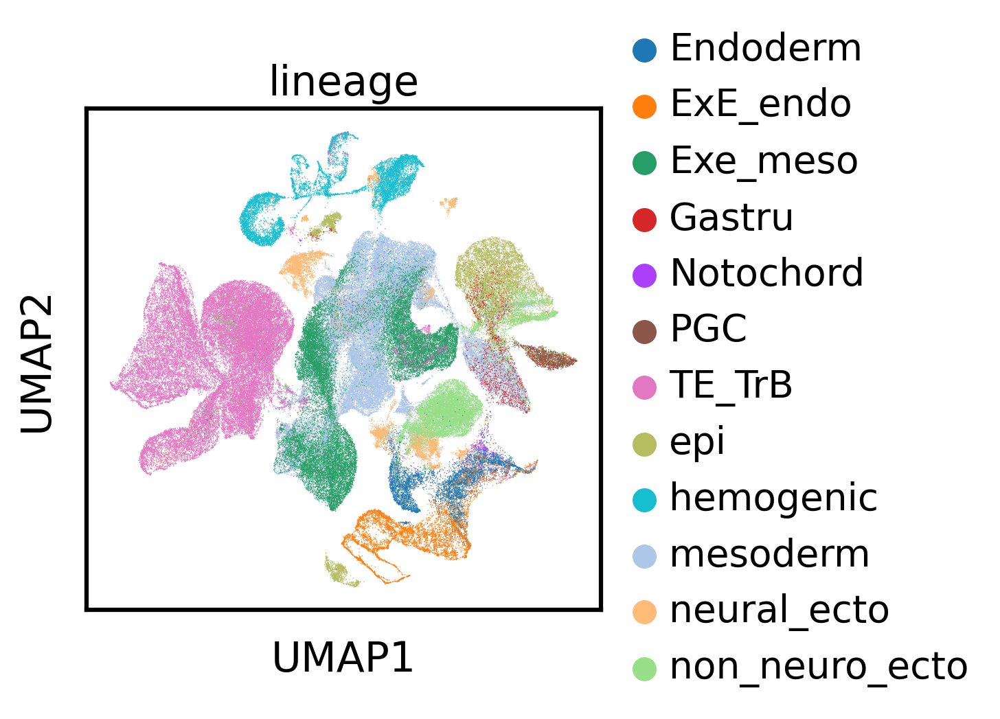

In [31]:
adata_hvg.obsm["LIGER"] = adata.obsm["LIGER"]
sc.pp.neighbors(adata, use_rep="LIGER",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"LIGER_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_LIGER'] = adata.obsm['X_umap']
adata_hvg.obsm['X_LIGER'] = adata.obsm['X_LIGER']
sc.pl.umap(adata, color=['orig.ident'],save="Liger_orig.ident.pdf")
sc.pl.umap(adata, color=['LIGER_res_0.5'],save="Liger_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="Liger_stage.pdf")
sc.pl.umap(adata, color=['lineage'],save="Liger_lineage.pdf")

In [32]:
###harmony
adata.obsm["Harmony"] = harmonize(adata_hvg.obsm["X_pca"], adata_hvg.obs, batch_key="orig.ident")

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
Reach convergence after 3 iteration(s).


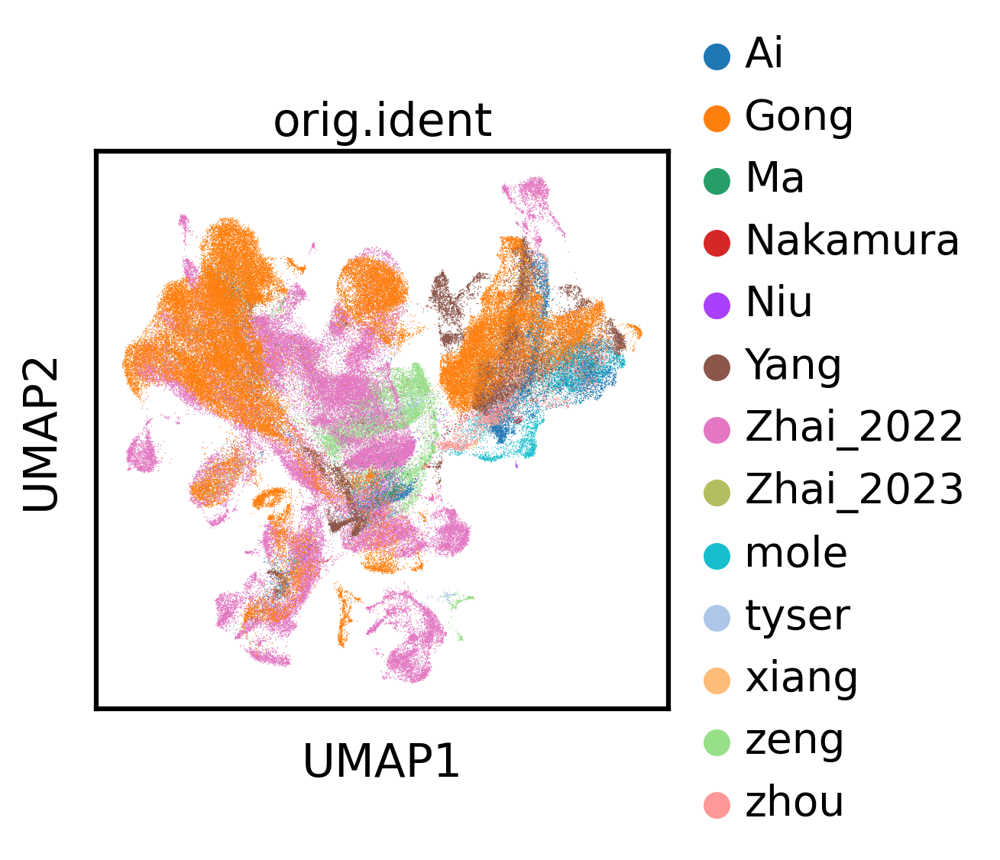

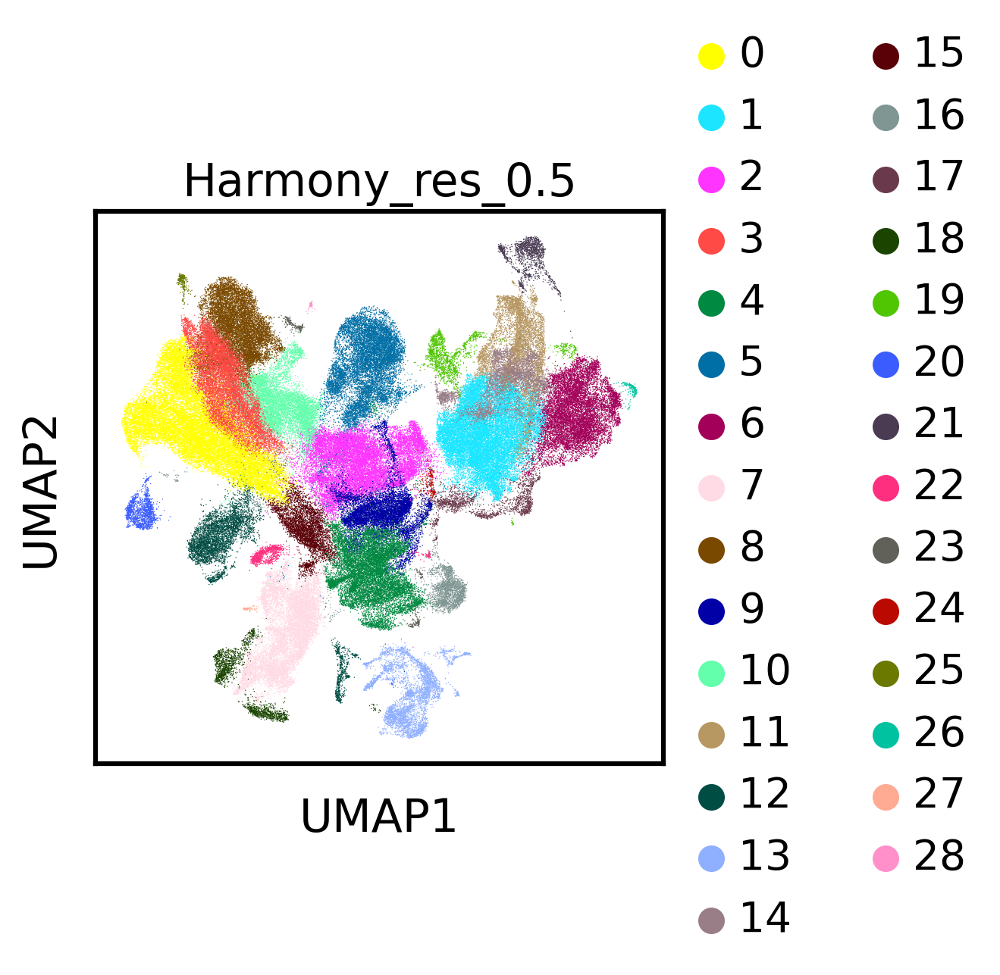

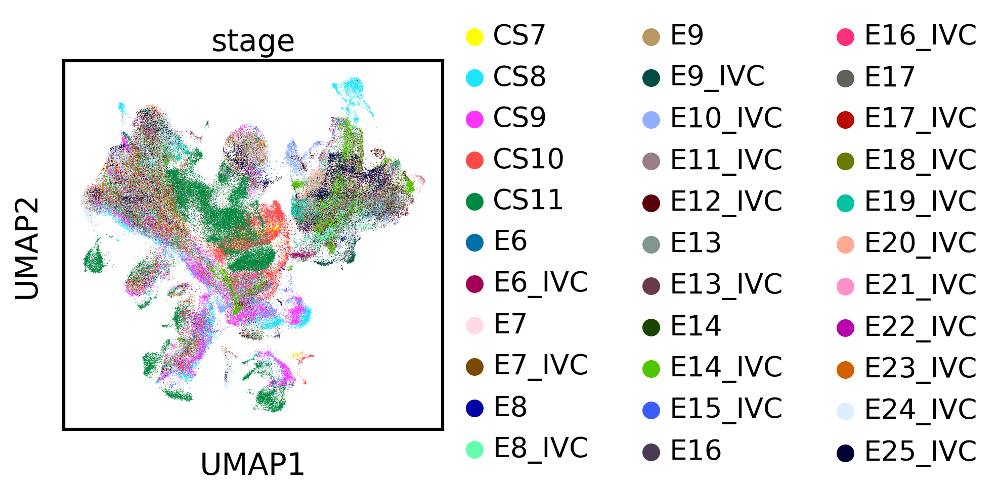

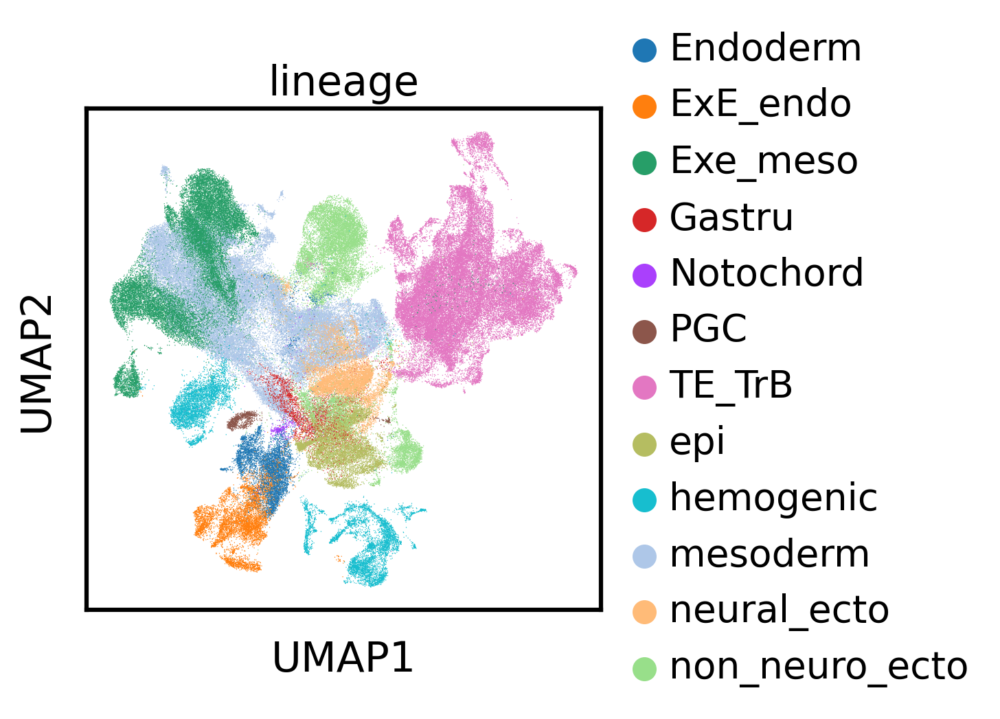

In [33]:
adata_hvg.obsm["Harmony"] = adata.obsm["Harmony"]
sc.pp.neighbors(adata, use_rep="Harmony",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"Harmony_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_Harmony'] = adata.obsm['X_umap']
adata_hvg.obsm['X_Harmony'] = adata.obsm['X_Harmony']
sc.pl.umap(adata, color=['orig.ident'],save="Harmony_orig.ident.pdf")
sc.pl.umap(adata, color=['Harmony_res_0.5'],save="Harmony_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="Harmony_stage.pdf")
sc.pl.umap(adata, color=['lineage'],save="Harmony_lineage.pdf")

In [34]:
###scVI
scvi.model.SCVI.setup_anndata(adata_hvg, layer="counts", batch_key="orig.ident")
vae = scvi.model.SCVI(adata_hvg, gene_likelihood="nb", n_layers=2, n_latent=30)
vae.train()
adata.obsm["scVI"] = vae.get_latent_representation()

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 46/46: 100%|██████████████████████████████████████████████████| 46/46 [12:51<00:00, 17.83s/it, loss=1.45e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=46` reached.


Epoch 46/46: 100%|██████████████████████████████████████████████████| 46/46 [12:51<00:00, 16.78s/it, loss=1.45e+03, v_num=1]


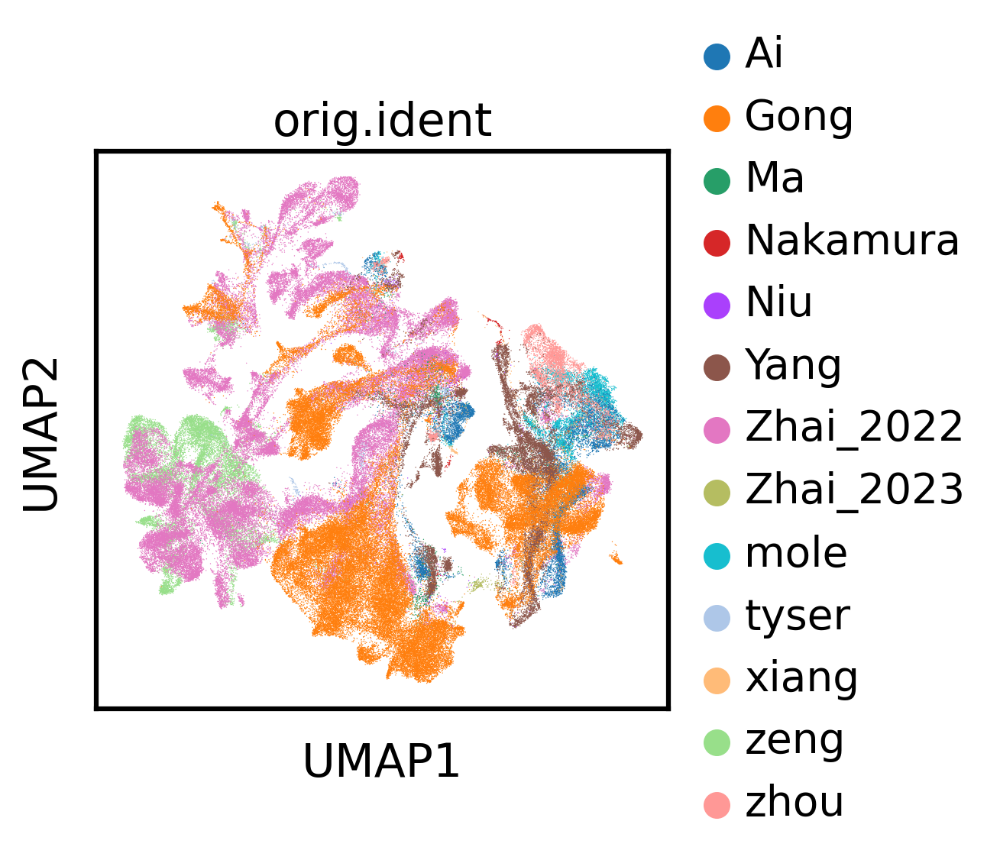

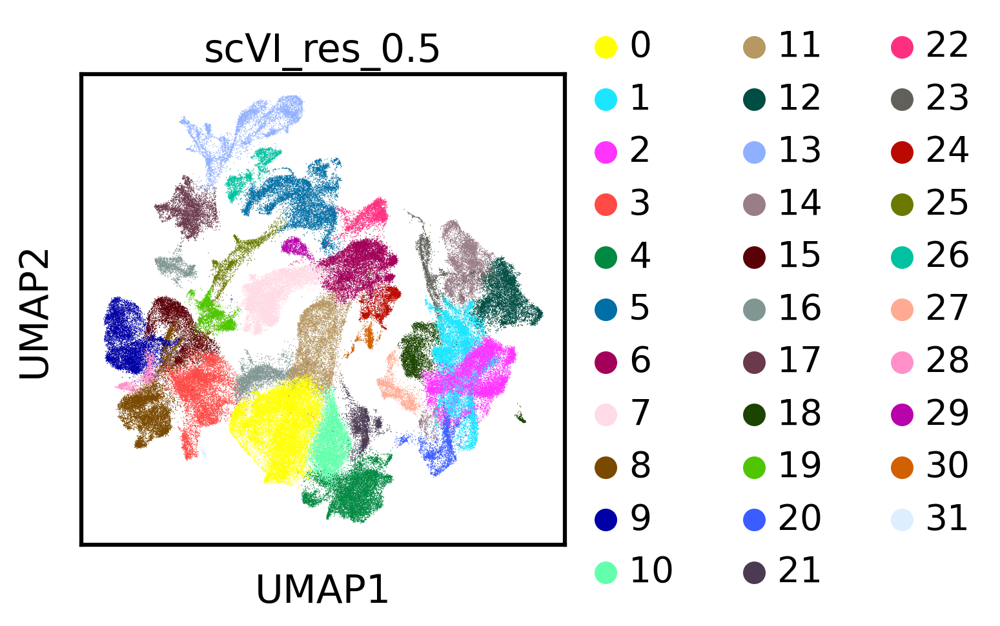

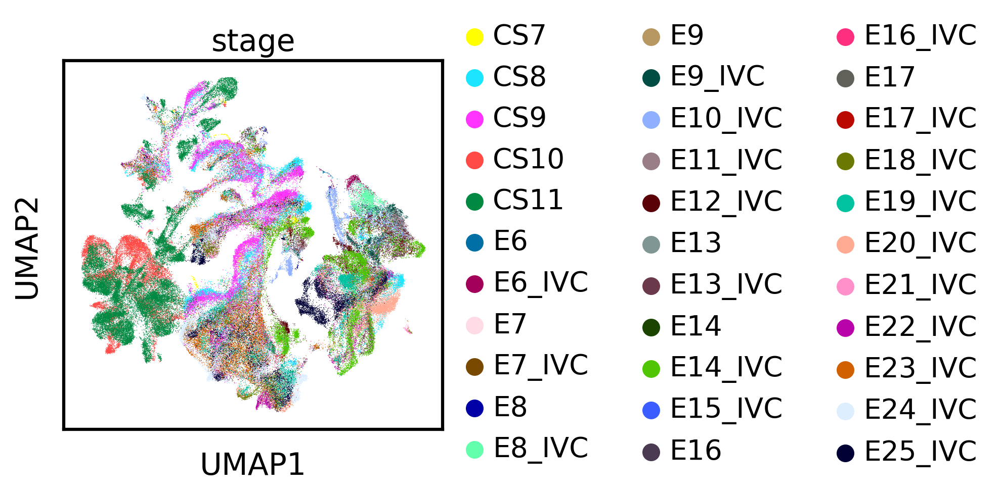

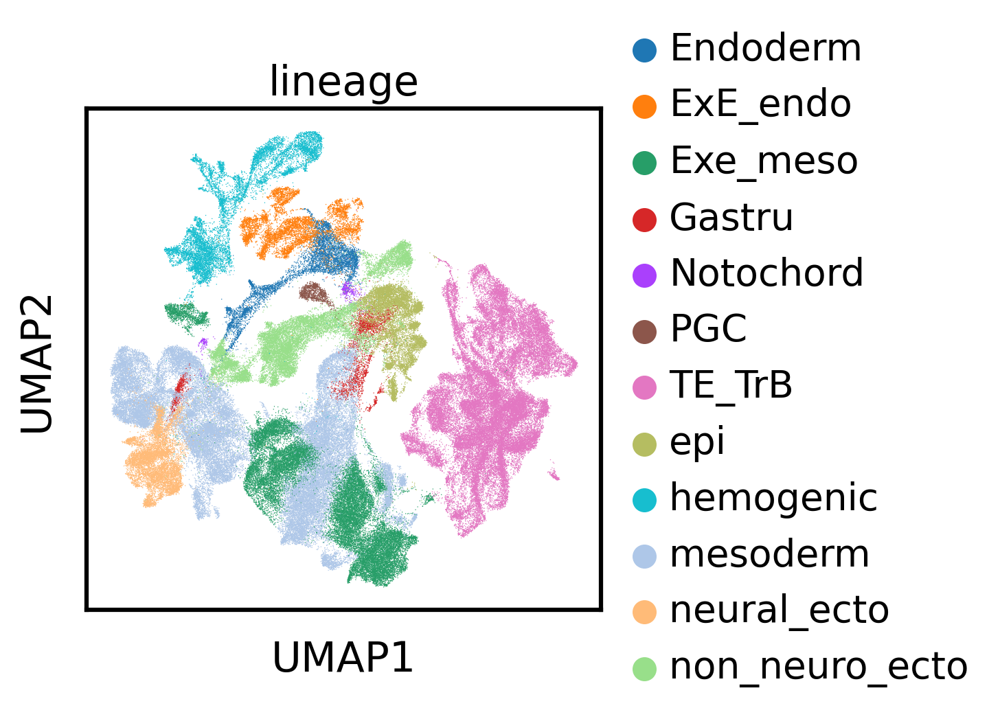

In [35]:
adata_hvg.obsm["scVI"] = adata.obsm["scVI"]
sc.pp.neighbors(adata, use_rep="scVI",random_state=42)
sc.tl.leiden(adata, resolution=0.5,key_added=f"scVI_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_scVI'] = adata.obsm['X_umap']
adata_hvg.obsm['X_scVI'] = adata.obsm['X_scVI']
sc.pl.umap(adata, color=['orig.ident'],save="scVI_orig.ident.pdf")
sc.pl.umap(adata, color=['scVI_res_0.5'],save="scVI_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="scVI_stage.pdf")
sc.pl.umap(adata, color=['lineage'],save="scVI_lineage.pdf")

In [36]:
###scANVI
lvae = scvi.model.SCANVI.from_scvi_model(
    vae,
    adata=adata_hvg,
    labels_key="lineage",
    unlabeled_category="Unknown",
)
lvae.train(max_epochs=20, n_samples_per_label=100)
adata.obsm["scANVI"] = lvae.get_latent_representation()

INFO     Training for 20 epochs.                                                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 20/20: 100%|██████████████████████████████████████████████████| 20/20 [12:17<00:00, 37.37s/it, loss=1.51e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|██████████████████████████████████████████████████| 20/20 [12:17<00:00, 36.89s/it, loss=1.51e+03, v_num=1]


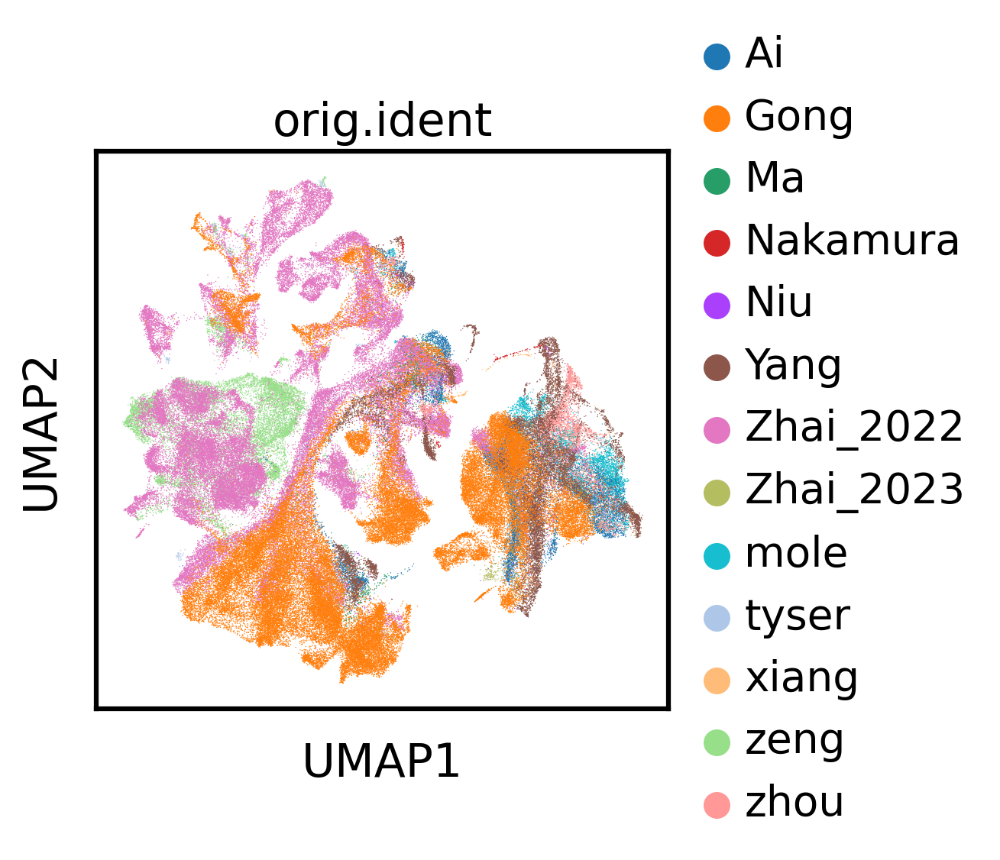

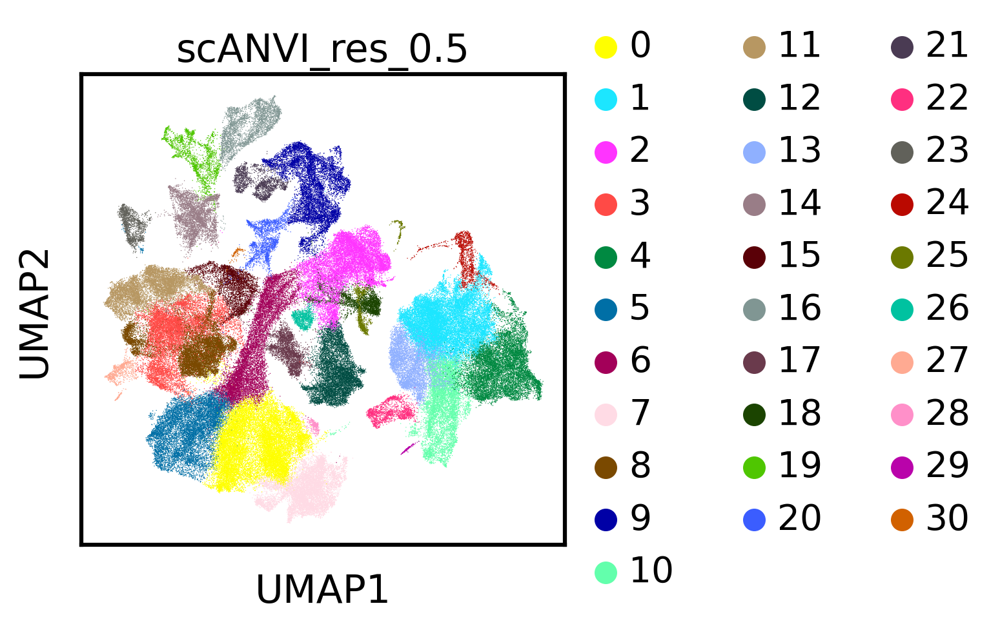

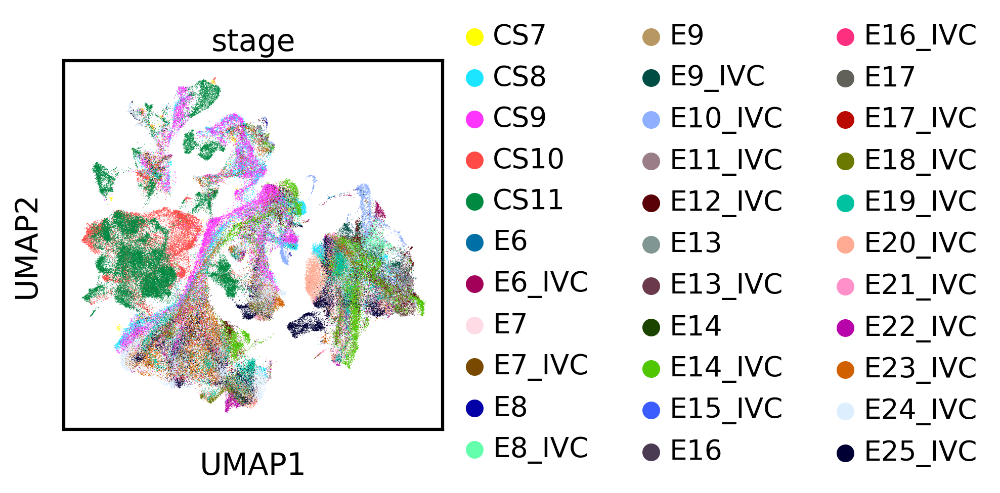

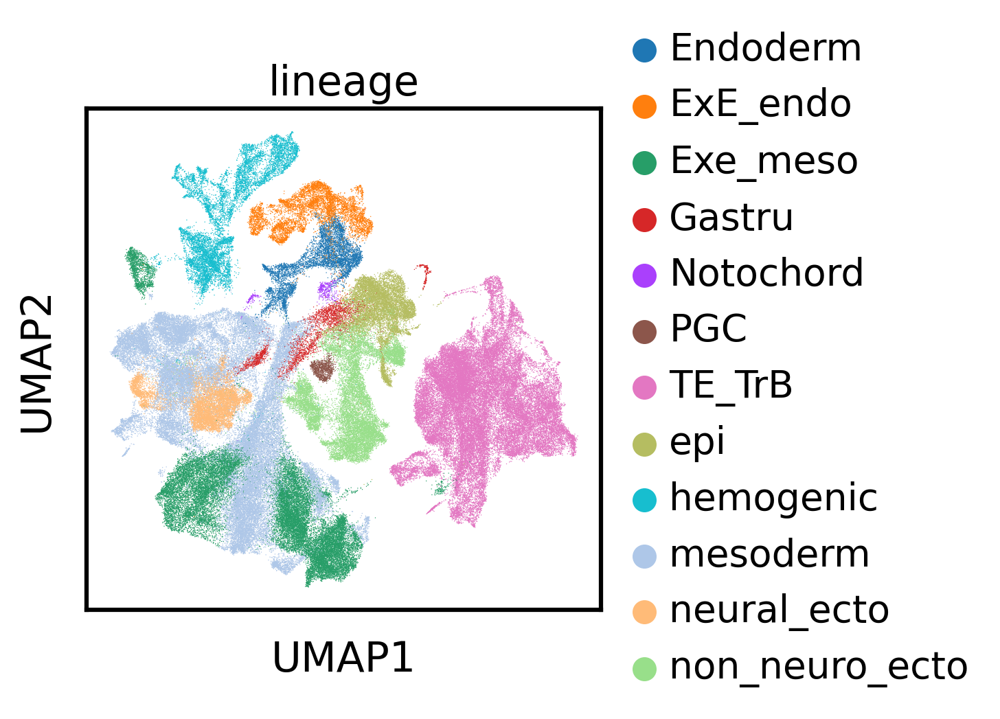

In [37]:
adata_hvg.obsm["scANVI"] = adata.obsm["scANVI"]
sc.pp.neighbors(adata, use_rep="scANVI",random_state=42)
sc.tl.leiden(adata, resolution=0.5,key_added=f"scANVI_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_scANVI'] = adata.obsm['X_umap']
adata_hvg.obsm['X_scANVI'] = adata.obsm['X_scANVI']
sc.pl.umap(adata, color=['orig.ident'],save="scANVI_orig.ident.pdf")
sc.pl.umap(adata, color=['scANVI_res_0.5'],save="scANVI_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="scANVI_stage.pdf")
sc.pl.umap(adata, color=['lineage'],save="scANVI_lineage.pdf")

In [38]:
####CCA
adata_seurat = adata_hvg.copy()

adata_seurat.obs["orig.ident"] = adata_seurat.obs["orig.ident"].astype(str)
adata_seurat.obs["lineage"] = adata_seurat.obs["lineage"].astype(str)

del adata_seurat.uns
adata_seurat

AnnData object with n_obs × n_vars = 175274 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation', '_scvi_batch', '_scvi_labels'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [39]:
import pandas as pd

# 查看 `obs` 中的每一列的数据类型
for col in adata_seurat.obs.columns:
    print(f"{col}: {adata_seurat.obs[col].dtype}")

# 同样地查看 `var` 中的每一列的数据类型
for col in adata_seurat.var.columns:
    print(f"{col}: {adata_seurat.var[col].dtype}")


# 检查 obs 和 var 的数据类型
print(adata_seurat.obs.dtypes)
print(adata_seurat.var.dtypes)

adata_seurat.obs = adata_seurat.obs.astype(str)
adata_seurat.var = adata_seurat.var.astype(str)

orig.ident: object

nCount_RNA: float64

nFeature_RNA: int32

sample: object

stage: category

percent.mt: float64

species: category

embryo: category

platform: category

ann_level_2: category

ann_level_3: category

ann_level_1: category

doublet: float64

doublet_score: float64

Unintegrated_res_0.5: category

Scanorama_res_0.5: category

LIGER_res_0.5: category

Harmony_res_0.5: category

scVI_res_0.5: category

scANVI_res_0.5: category

CCA_res_0.5: category

FastMNN_res_0.5: category

leiden_1: category

leiden_2: category

leiden_3: category

leiden_4: category

reanno: category

lineage: object

unicorns: category

combined_annotation: category

_scvi_batch: int8

_scvi_labels: int8

n_cells: int64

highly_variable: bool

means: float64

dispersions: float64

dispersions_norm: float32

highly_variable_nbatches: int64

highly_variable_intersection: bool

orig.ident                object
nCount_RNA               float64
nFeature_RNA               int32
sample                    object
stage                   category
percent.mt               float64
species                 category
embryo                  category
platform                category
ann_level_2             category
ann_level_3             category
ann_level_1             category
doublet                  float64
doublet_score            float64
Unintegrated_res_0.5    category
Scanorama_res_0.5       category
LIGER_res_0.5           category
Harmony_res_0.5         category
scVI_res_0.5            category
scANVI_res_0.5          category
CCA_res_0.5             category
FastMNN_res_0.5         category
leiden_1                category
leiden_2                category
leiden_3                category
leiden_4                category
reanno                  category
lineage                   object
unicorns                category
combined_annotation     category
_scvi_batch                 int8
_scvi_labels                int8
dtype: object

n_cells                           int64
highly_variable                    bool
means                           float64
dispersions                     float64
dispersions_norm                float32
highly_variable_nbatches          int64
highly_variable_intersection       bool
dtype: object

In [40]:
#####to R
%R -i adata_seurat
adata_seurat

In addition: Warning messages:
1: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages
2: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages
3: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages
4: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  library ‘/usr/lib/R/site-library’ contains no packages


AnnData object with n_obs × n_vars = 175274 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation', '_scvi_batch', '_scvi_labels'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [41]:
import pandas as pd

if not adata_seurat.obs_names.is_unique:
    print("细胞名称不是唯一的。正在添加唯一后缀。")
    adata_seurat.obs_names = pd.Index([f"{name}_{i}" if adata_seurat.obs_names.duplicated()[i] else name
                                       for i, name in enumerate(adata_seurat.obs_names)])
assert adata_seurat.obs_names.is_unique, "细胞名称仍然不是唯一的！"

细胞名称不是唯一的。正在添加唯一后缀。

In [42]:
%%R -i adata_seurat
library(Seurat)
seurat <- as.Seurat(adata_seurat, counts = "counts", data = "logcounts")
seurat

An object of class Seurat 
2000 features across 175274 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 18 dimensional reductions calculated: CCA, FastMNN, Harmony, LIGER, Scanorama, Unintegrated, X_CCA, X_FastMNN, X_Harmony, X_LIGER, X_Scanorama, X_Unintegrated, PCA, X_scANVI, X_scVI, UMAP, scANVI, scVI


In [43]:
label_key = "lineage"
batch_key = "orig.ident"

In [44]:
%%R -i batch_key
batch_list <- SplitObject(seurat, split.by = "orig.ident")
batch_list

$mole
An object of class Seurat 
2000 features across 5205 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 18 dimensional reductions calculated: CCA, FastMNN, Harmony, LIGER, Scanorama, Unintegrated, X_CCA, X_FastMNN, X_Harmony, X_LIGER, X_Scanorama, X_Unintegrated, PCA, X_scANVI, X_scVI, UMAP, scANVI, scVI

$zeng
An object of class Seurat 
2000 features across 13680 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 18 dimensional reductions calculated: CCA, FastMNN, Harmony, LIGER, Scanorama, Unintegrated, X_CCA, X_FastMNN, X_Harmony, X_LIGER, X_Scanorama, X_Unintegrated, PCA, X_scANVI, X_scVI, UMAP, scANVI, scVI

$Ai
An object of class Seurat 
2000 features across 8611 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 18 dimensional reductions calculated: CCA, FastMNN, Harmon

In [45]:
%%R
anchors <- FindIntegrationAnchors(batch_list, anchor.features = rownames(seurat))
anchors

  |                                                  | 0 % ~calculating   |++++                                              | 8 % ~05s           |++++++++                                          | 15% ~07s           |++++++++++++                                      | 23% ~07s           |++++++++++++++++                                  | 31% ~05s           |++++++++++++++++++++                              | 38% ~03s           |++++++++++++++++++++++++                          | 46% ~03s           |+++++++++++++++++++++++++++                       | 54% ~02s           |+++++++++++++++++++++++++++++++                   | 62% ~04s           |+++++++++++++++++++++++++++++++++++               | 69% ~03s           |+++++++++++++++++++++++++++++++++++++++           | 77% ~02s           |+++++++++++++++++++++++++++++++++++++++++++       | 85% ~01s           |+++++++++++++++++++++++++++++++++++++++++++++++   | 92% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elap

Scaling features for provided objects
Finding all pairwise anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 17603 anchors
Filtering anchors
	Retained 1349 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 12540 anchors
Filtering anchors
	Retained 5469 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 19651 anchors
Filtering anchors
	Retained 2152 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 4688 anchors
Filtering anchors
	Retained 1810 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 4522 anchors
Filtering anchors
	Retained 3476 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 4281 anchors
Filtering anchors
	Retained 2261 anchors
Running CCA
Merging objects
Finding neighborhoods
Finding anchors
	Found 2099 anchors
Filtering anchors
	Retained 1887 anchors
Running CCA
Merging objects
Finding neigh

In [46]:
%%R
integrated <- IntegrateData(anchors, k.weight = 30)
integrated

An object of class Seurat 
4000 features across 175274 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 1 layer present: data
 1 other assay present: originalexp


Merging dataset 7 into 3
Extracting anchors for merged samples
Finding integration vectors
Finding integration vector weights
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Integrating data
Merging dataset 13 into 11
Extracting anchors for merged samples
Finding integration vectors
Finding integration vector weights
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Integrating data
Merging dataset 10 into 8
Extracting anchors for merged samples
Finding integration vectors
Finding integration vector weights
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Integrating data
Merging dataset 5 into 1
Extracting anchors for merged samples
Finding integration vectors


In [47]:
%%R
integrated

An object of class Seurat 
4000 features across 175274 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 1 layer present: data
 1 other assay present: originalexp


In [48]:
%%R -o integrated_expr
integrated_expr <- GetAssayData(integrated)

integrated_expr <- integrated_expr[rownames(seurat), colnames(seurat)]

integrated_expr <- t(integrated_expr)
print(integrated_expr[1:10, 1:10])

10 x 10 sparse Matrix of class "dgCMatrix"
                                                                    
AAACCTGAGACGCTTT-1_1_1_1_1_1_1  1.642410e-03  0.19383542  0.50632981
AACGTTGAGACGCAAC-1_1_1_1_1_1_1  2.250884e-02 -0.42277381 -0.02544202
AACTCAGCAGACGCCT-1_1_1_1_1_1_1  1.349717e-03 -0.54487510  0.02477809
AAGACCTTCGGCGCTA-1_1_1_1_1_1_1 -9.452304e-05 -0.17001105  0.08010547
AAGCCGCCATATGGTC-1_1_1_1_1_1_1  7.469212e-03  0.18221068 -0.08553053
AAGTCTGAGTACGCGA-1_1_1_1_1_1_1  1.002602e-02  0.27016257  0.13696653
AATCCAGAGTTGAGTA-1_1_1_1_1_1_1  1.214846e-02  0.70922636  0.02945489
AATCCAGTCCAGAGGA-1_1_1_1_1_1_1  6.788630e-03  0.53292087  0.32243814
ACACCCTGTCTACCTC-1_1_1_1_1_1_1  8.889262e-03 -0.02292872  0.49900419
ACATCAGTCTGTCCGT-1_1_1_1_1_1_1  6.407124e-03  0.36076274  0.34404317
                                                                      
AAACCTGAGACGCTTT-1_1_1_1_1_1_1  0.127176096  0.061244420 -0.0017125876
AACGTTGAGACGCAAC-1_1_1_1_1_1_1  0.456257114  0.085642898

  [[ suppressing 10 column names ‘A2M’, ‘AADAT’, ‘AASS’ ... ]]


In [49]:
## save to adata key
adata_seurat.X = integrated_expr
adata_seurat.layers["seurat"] = integrated_expr
print(adata_seurat)
adata.X

AnnData object with n_obs × n_vars = 175274 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 
'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 
'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 
'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 
'combined_annotation', '_scvi_batch', '_scvi_labels'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 
'highly_variable_intersection'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 
'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts', 'seurat'

<175274x84580 sparse matrix of type '<class 'numpy.float64'>'
	with 881100418 stored elements in Compressed Sparse Row format>

In [50]:
sc.pp.highly_variable_genes(adata_seurat)
print(adata_seurat.var['highly_variable'])
sc.tl.pca(adata_seurat)
adata.obsm["CCA"] = adata_seurat.obsm["X_pca"]
adata_hvg.obsm["CCA"] = adata_seurat.obsm["X_pca"]

/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:212: RuntimeWarning: invalid value encountered in log


A2M         True
AADAT      False
AASS       False
ABCA1      False
ABCB11     False
           ...  
ZNF804A     True
ZNF804B     True
ZSCAN10    False
ZSCAN4     False
ZYG11A     False
Name: highly_variable, Length: 2000, dtype: bool

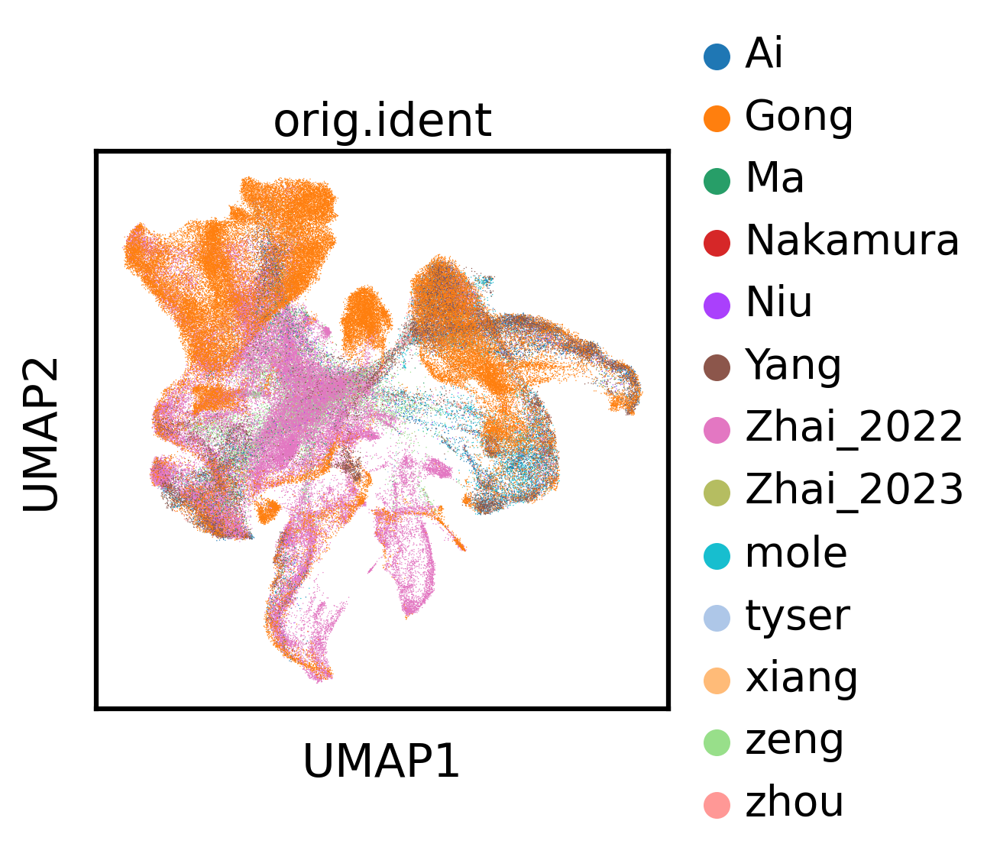

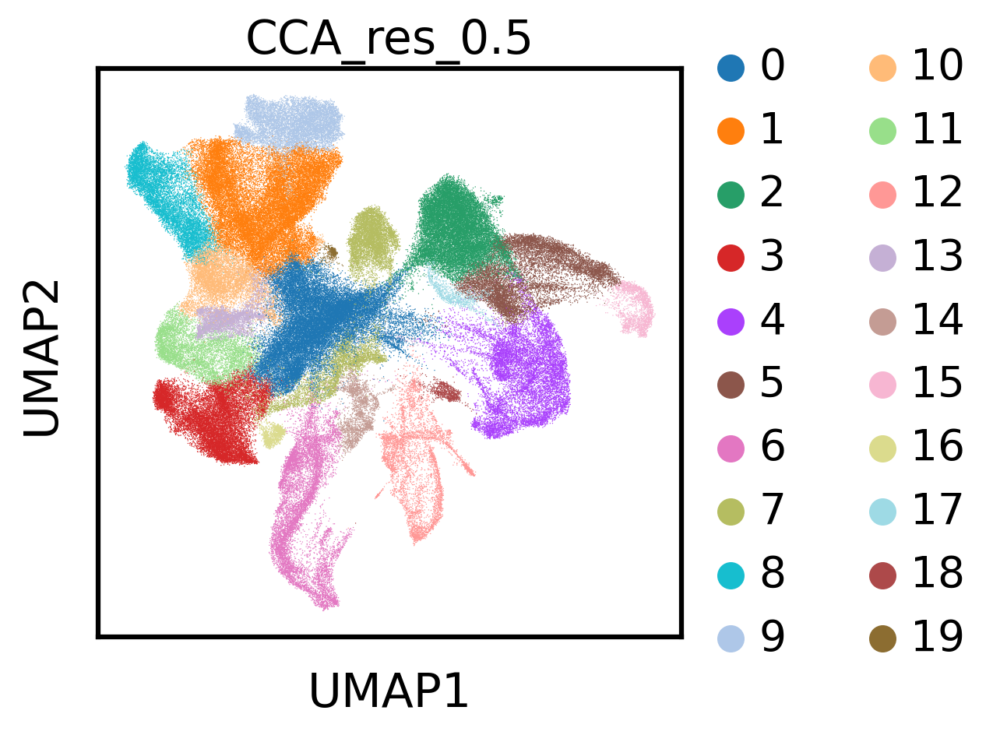

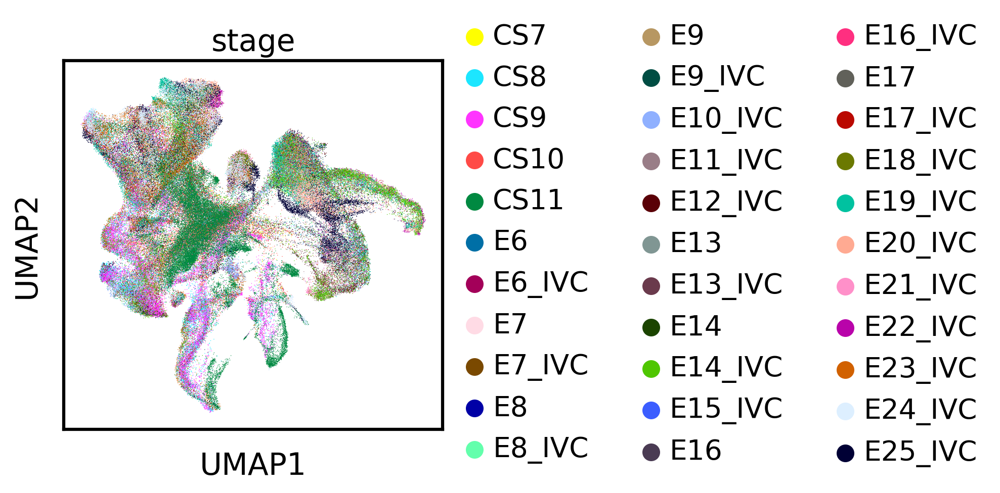

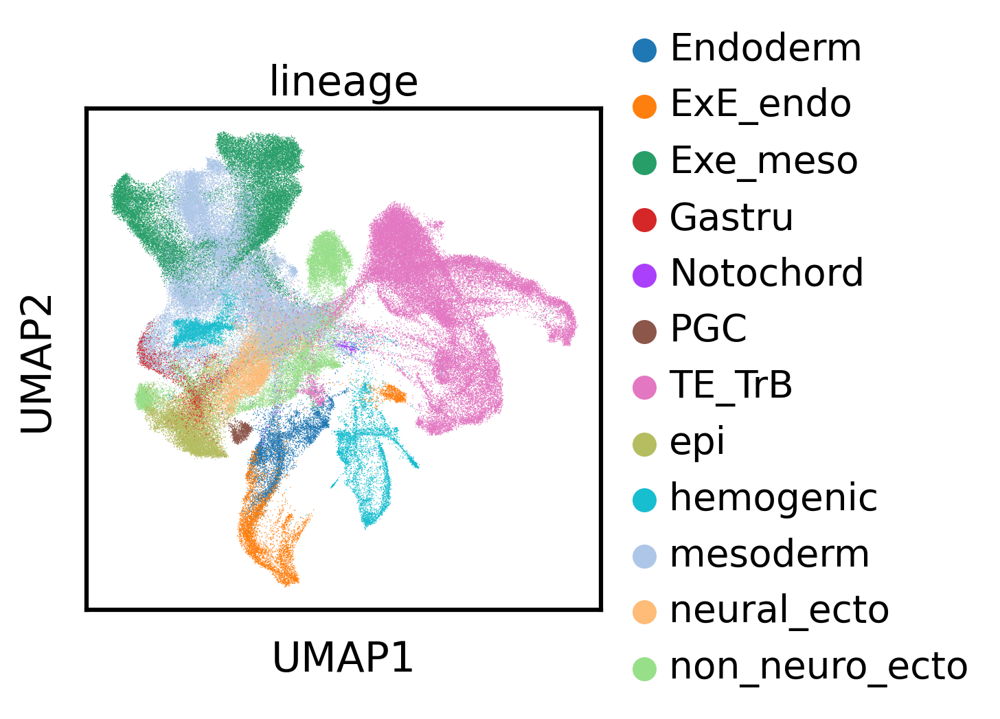

In [51]:
sc.pp.neighbors(adata, use_rep="CCA",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"CCA_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_CCA'] = adata.obsm['X_umap']
adata_hvg.obsm['X_CCA'] = adata.obsm['X_CCA']
sc.pl.umap(adata, color=['orig.ident'],save="CCA_orig.ident.pdf")
sc.pl.umap(adata, color=['CCA_res_0.5'],save="CCA_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="CCA_stage.pdf")
sc.pl.umap(adata, color=['lineage'],save="CCA_lineage.pdf")

In [52]:
###fastmnn
adata_fastmnn = adata_hvg.copy()
adata_fastmnn

AnnData object with n_obs × n_vars = 175274 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation', '_scvi_batch', '_scvi_labels'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [53]:
adata_fastmnn.obs["orig.ident"] = adata_fastmnn.obs["orig.ident"].astype(str)
adata_fastmnn.obs["lineage"] = adata_fastmnn.obs["lineage"].astype(str)

del adata_fastmnn.uns
adata_fastmnn

AnnData object with n_obs × n_vars = 175274 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation', '_scvi_batch', '_scvi_labels'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [54]:
adata_fastmnn.obs = adata_fastmnn.obs.astype(str)
adata_fastmnn.var = adata_fastmnn.var.astype(str)

In [55]:
#####to R
%R -i adata_fastmnn
adata_fastmnn

AnnData object with n_obs × n_vars = 175274 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation', '_scvi_batch', '_scvi_labels'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'

In [56]:
import pandas as pd

if not adata_fastmnn.obs_names.is_unique:
    print("细胞名称不是唯一的。正在添加唯一后缀。")
    adata_fastmnn.obs_names = pd.Index(
        [f"{name}_{i}" if adata_fastmnn.obs_names.duplicated()[i] else name
         for i, name in enumerate(adata_fastmnn.obs_names)]
    )

assert adata_fastmnn.obs_names.is_unique, "细胞名称仍然不是唯一的！"

细胞名称不是唯一的。正在添加唯一后缀。

In [57]:
%%R -i adata_fastmnn
library(Seurat)
fastmnn <- as.Seurat(adata_fastmnn, counts = "counts", data = "logcounts")
fastmnn

An object of class Seurat 
2000 features across 175274 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 18 dimensional reductions calculated: CCA, FastMNN, Harmony, LIGER, Scanorama, Unintegrated, X_CCA, X_FastMNN, X_Harmony, X_LIGER, X_Scanorama, X_Unintegrated, PCA, X_scANVI, X_scVI, UMAP, scANVI, scVI


In [58]:
label_key = "lineage"
batch_key = "orig.ident"

In [59]:
%%R -i batch_key
batch_list <- SplitObject(fastmnn, split.by = "orig.ident")
batch_list

$mole
An object of class Seurat 
2000 features across 5205 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 18 dimensional reductions calculated: CCA, FastMNN, Harmony, LIGER, Scanorama, Unintegrated, X_CCA, X_FastMNN, X_Harmony, X_LIGER, X_Scanorama, X_Unintegrated, PCA, X_scANVI, X_scVI, UMAP, scANVI, scVI

$zeng
An object of class Seurat 
2000 features across 13680 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 18 dimensional reductions calculated: CCA, FastMNN, Harmony, LIGER, Scanorama, Unintegrated, X_CCA, X_FastMNN, X_Harmony, X_LIGER, X_Scanorama, X_Unintegrated, PCA, X_scANVI, X_scVI, UMAP, scANVI, scVI

$Ai
An object of class Seurat 
2000 features across 8611 samples within 1 assay 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 18 dimensional reductions calculated: CCA, FastMNN, Harmon

In [60]:
%%R
library(Seurat)
library(tidyverse)
library(patchwork)
library(SeuratWrappers)
fastmnn_test <- RunFastMNN(object.list = batch_list)
fastmnn_test

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.0     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ lubridate::%within%() masks IRanges::%within%()
✖ dplyr::collapse()     masks IRanges::collapse()
✖ dplyr::combine()      masks Biobase::combine(), BiocGenerics::combine()
✖ dplyr::count()        masks matrixStats::count()
✖ dplyr::desc()         masks IRanges::desc()
✖ tidyr::expand()       masks Matrix::expand(), S4Vectors::expand()
✖ dplyr::filter()       masks stats::filter()
✖ dplyr::first()        masks S4Vectors::first()
✖ dplyr::lag()          masks stats::lag()
✖ tidyr::pack()         masks Matrix::pack()
✖ ggplot2::Position()   masks BiocGenerics::Position(), base::Position()
✖ purrr::reduce()       masks GenomicRanges::reduce(), IRang

Computing 2000 integration features
No variable features found for object1 in the object.list. Running FindVariableFeatures ...
Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
No variable features found for object2 in the object.list. Running FindVariableFeatures ...
Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
************

In [61]:
%%R
fastmnn_test

An object of class Seurat 
4000 features across 175274 samples within 2 assays 
Active assay: originalexp (2000 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: mnn.reconstructed
 1 dimensional reduction calculated: mnn


In [62]:
%%R -o fastmnn_expr
fastmnn_expr <- GetAssayData(fastmnn_test, assay = "mnn.reconstructed")

fastmnn_expr <- fastmnn_expr[rownames(fastmnn), colnames(fastmnn)]

fastmnn_expr <- t(fastmnn_expr)
print(fastmnn_expr[1:10, 1:10])

10 x 10 sparse Matrix of class "dgCMatrix"
                                                                        
AAACCTGAGACGCTTT-1_1_1_1_1_1_1 -0.0011697883 -0.0074961205  0.0111481532
AACGTTGAGACGCAAC-1_1_1_1_1_1_1 -0.0046863837  0.0131949856 -0.0113855804
AACTCAGCAGACGCCT-1_1_1_1_1_1_1 -0.0049727208  0.0226530752 -0.0133414255
AAGACCTTCGGCGCTA-1_1_1_1_1_1_1 -0.0018368139 -0.0008894635 -0.0048661733
AAGCCGCCATATGGTC-1_1_1_1_1_1_1 -0.0088442725 -0.0026710891  0.0054335912
AAGTCTGAGTACGCGA-1_1_1_1_1_1_1 -0.0031820992 -0.0036052851 -0.0013483118
AATCCAGAGTTGAGTA-1_1_1_1_1_1_1 -0.0044964646  0.0237926095 -0.0091147320
AATCCAGTCCAGAGGA-1_1_1_1_1_1_1 -0.0002358386 -0.0061032856  0.0047512380
ACACCCTGTCTACCTC-1_1_1_1_1_1_1 -0.0038425317 -0.0042138809  0.0482889199
ACATCAGTCTGTCCGT-1_1_1_1_1_1_1 -0.0021865780 -0.0023900205  0.0003749303
                                                                       
AAACCTGAGACGCTTT-1_1_1_1_1_1_1 -0.009322733 -0.0006783049  4.383374e-04
AACGTTGAGA

  [[ suppressing 10 column names ‘A2M’, ‘AADAT’, ‘AASS’ ... ]]


In [63]:
## save to adata key
adata_fastmnn.X = fastmnn_expr
adata_fastmnn.layers["fastmnn"] = fastmnn_expr
print(adata_fastmnn)
adata.X

AnnData object with n_obs × n_vars = 175274 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 
'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 
'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 
'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 
'combined_annotation', '_scvi_batch', '_scvi_labels'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 
'highly_variable_intersection'
    obsm: 'CCA', 'FastMNN', 'Harmony', 'LIGER', 'Scanorama', 'Unintegrated', 'X_CCA', 'X_FastMNN', 'X_Harmony', 
'X_LIGER', 'X_Scanorama', 'X_Unintegrated', 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'scANVI', 'scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts', 'fastmnn'

<175274x84580 sparse matrix of type '<class 'numpy.float64'>'
	with 881100418 stored elements in Compressed Sparse Row format>

In [65]:
sc.pp.highly_variable_genes(adata_fastmnn)
print(adata_fastmnn.var['highly_variable'])
sc.tl.pca(adata_fastmnn)
adata.obsm["FastMNN"] = adata_fastmnn.obsm["X_pca"]
adata_hvg.obsm["FastMNN"] = adata_fastmnn.obsm["X_pca"]

/home/lanxiang/miniconda3/envs/sc/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:212: RuntimeWarning: invalid value encountered in log


A2M        False
AADAT      False
AASS       False
ABCA1      False
ABCB11     False
           ...  
ZNF804A    False
ZNF804B    False
ZSCAN10    False
ZSCAN4     False
ZYG11A     False
Name: highly_variable, Length: 2000, dtype: bool

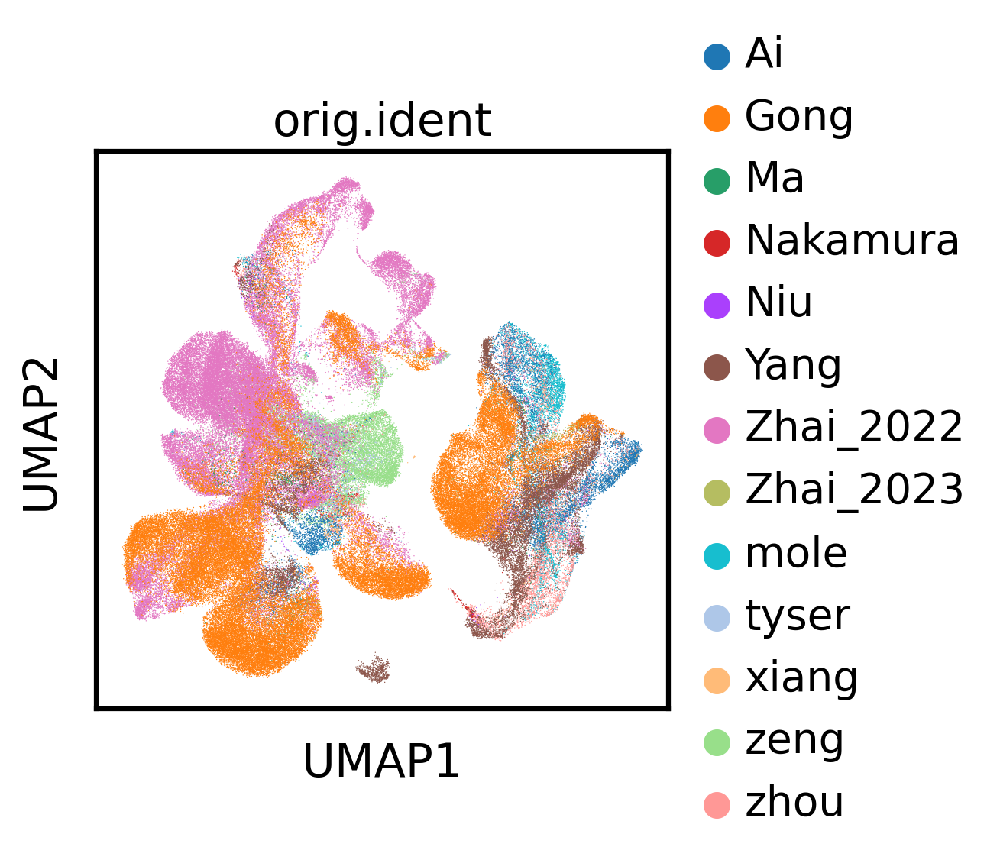

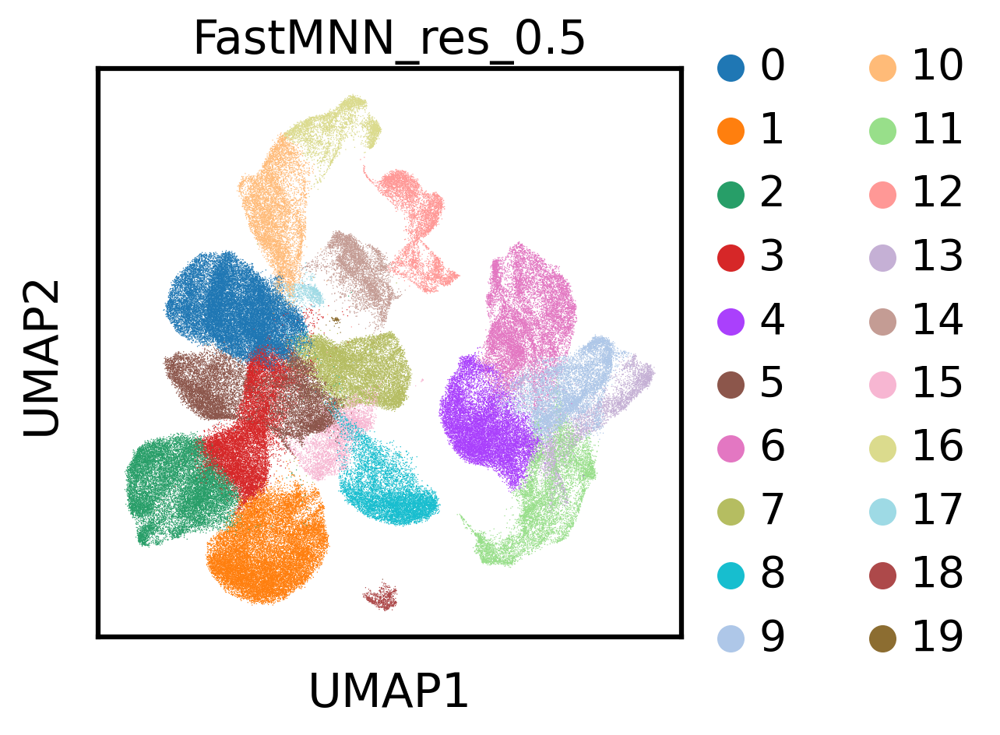

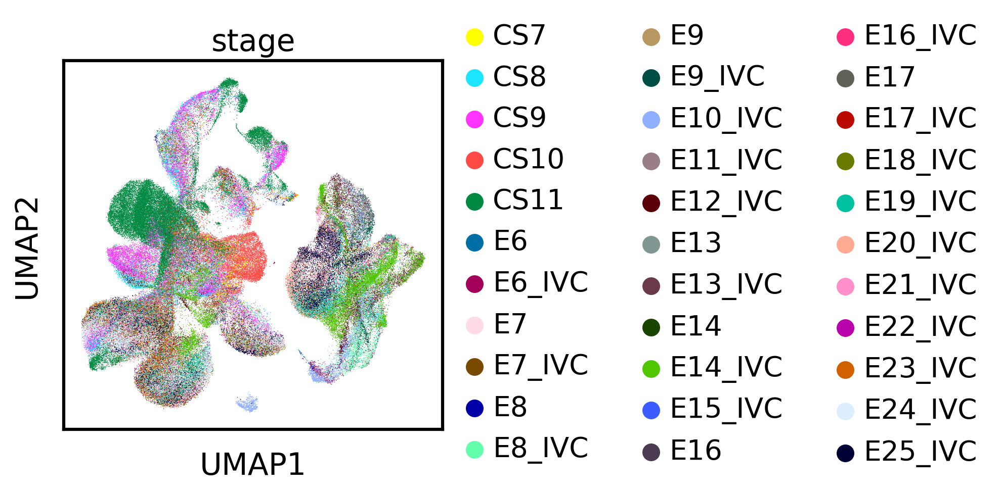

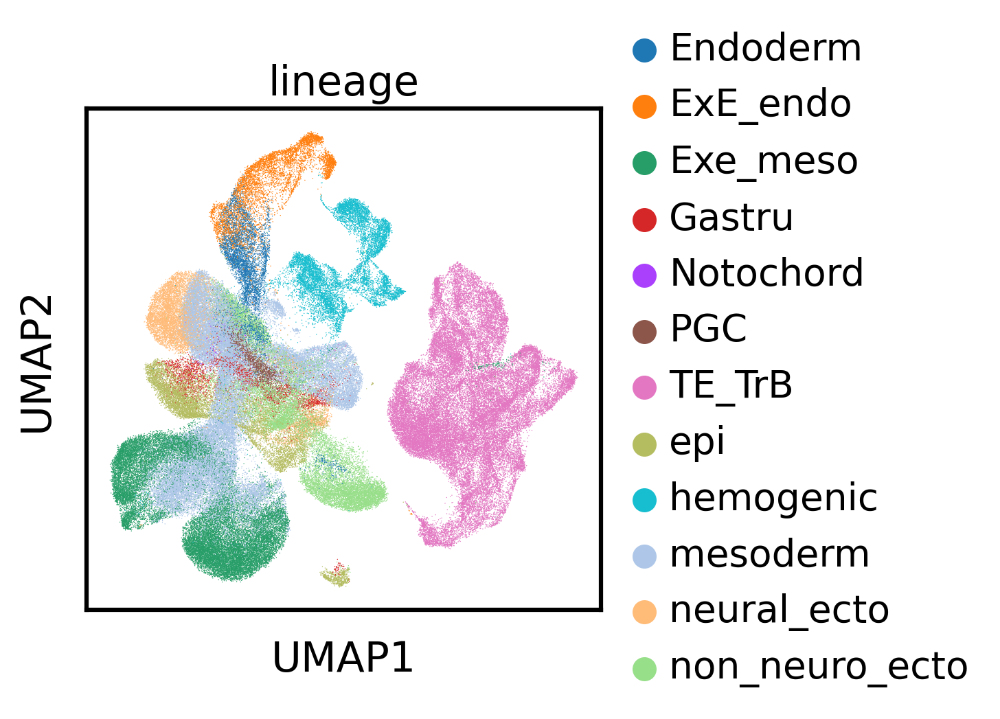

In [66]:
sc.pp.neighbors(adata, use_rep="FastMNN",random_state=42)
sc.tl.leiden(adata, resolution=0.5, key_added=f"FastMNN_res_0.5",random_state=42)
sc.tl.umap(adata,random_state=42)
adata.obsm['X_FastMNN'] = adata.obsm['X_umap']
adata_hvg.obsm['X_FastMNN'] = adata.obsm['X_FastMNN']
sc.pl.umap(adata, color=['orig.ident'],save="FastMNN_orig.ident.pdf")
sc.pl.umap(adata, color=['FastMNN_res_0.5'],save="FastMNN_res_0.5.pdf")
sc.pl.umap(adata, color=['stage'],save="FastMNN_stage.pdf")
sc.pl.umap(adata, color=['lineage'],save="FastMNN_lineage.pdf")

In [67]:
adata

AnnData object with n_obs × n_vars = 175274 × 84580
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'reanno', 'lineage', 'unicorns', 'combined_annotation'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'umap', 'orig.ident_colors', 'Unintegrated_res_0.5_colors', 'stage_colors', 'lineage_colors', 'Scanorama_res_0.5_colors', 'LIGER_res_0.5_colors', 'Harmony_res_0.5_colors', 'scVI_res_0.5_colors', 'scANVI_res_0.5_colors', 'CCA_res_0.5_colors', 'FastMNN_res_0.5_colors'
    obsm: 'CCA', 'FastMNN', 'Harmony', '

In [68]:
####Perform the benchmark
bm = Benchmarker(
    adata,
    batch_key="orig.ident",
    label_key="lineage",
    embedding_obsm_keys=["Unintegrated", "Scanorama", "LIGER", "Harmony", "scVI", "scANVI","CCA","FastMNN"],
    n_jobs=6,
)
bm.benchmark()

Metrics:   0%|                                                                                       | 0/10 [00:00<?, ?it/s]
                                                                                                                            
Metrics:   0%|                                                                                       | 0/10 [00:00<?, ?it/s]
                                                                                                                            
Metrics:   0%|                                                                                       | 0/10 [00:00<?, ?it/s]
                                                                                                                            
Metrics:   0%|                                                                                       | 0/10 [00:00<?, ?it/s]
                                                                                                                            


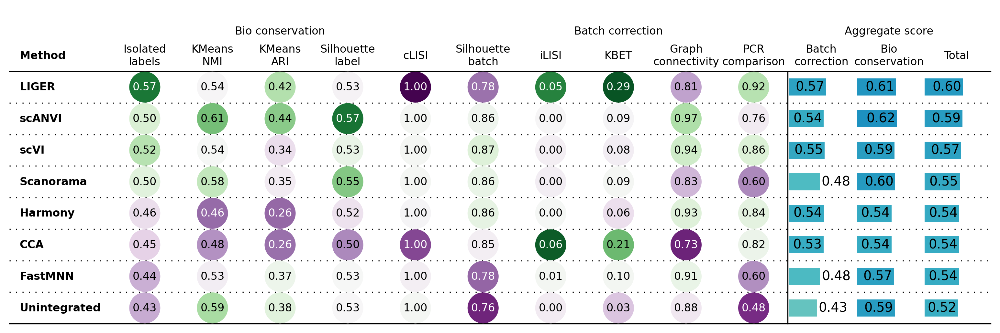

In [69]:
bm.plot_results_table(min_max_scale=False,save_dir="/mnt/disk5/Lanxiang/Human_integrated/integrated/10.29_update/fig")

In [70]:

from rich import print

df = bm.get_results(min_max_scale=False)
print(df)
df.to_csv('/mnt/disk5/Lanxiang/Human_integrated/integrated/10.29_update/fig/scib_df_min_max_scale=False.csv')


Isolated labels        KMeans NMI        KMeans ARI  \
Embedding                                                            
Unintegrated          0.434059          0.592635          0.383026   
Scanorama              0.49513          0.579199          0.348332   
LIGER                 0.572085          0.539017          0.415658   
Harmony               0.460722          0.458879          0.259077   
scVI                  0.516983          0.543078          0.335893   
scANVI                0.500775          0.611865          0.435097   
CCA                   0.453686            0.4781          0.263718   
FastMNN               0.436461           0.53339          0.370347   
Metric Type   Bio conservation  Bio conservation  Bio conservation   

              Silhouette label             cLISI  Silhouette batch  \
Embedding                                                            
Unintegrated          0.527242               1.0          0.755839   
Scanorama             0.554284               1.0          0.860992   
LIGER                   0.5257          0.995966          0.782962   
Harmony               0.520611          0.999828          0.863374   
scVI                  0.532072               1.0          0.869776   
scANVI                0.572299               1.0           0.85605   
CCA                   0.499452          0.997034          0.845192   
FastMNN               0.527369          0.999696          0.777748   
Metric Type   Bio conservation  Bio conservation  Batch correction   

                         iLISI              KBET Graph connectivity  \
Embedding                                                             
Unintegrated               0.0          0.032087            0.87695   
Scanorama             0.000368          0.093453           0.830719   
LIGER                 0.052656          0.294299           0.813014   
Harmony               0.004978          0.060345           0.927201   
scVI                   0.00111          0.076487           0.942628   
scANVI                0.003622          0.085884           0.968206   
CCA                   0.061193          0.210162           0.728102   
FastMNN                0.00593          0.095119            0.91369   
Metric Type   Batch correction  Batch correction   Batch correction   

                PCR comparison Batch correction Bio conservation  \
Embedding                                                          
Unintegrated          0.479844         0.428944         0.587392   
Scanorama             0.595468           0.4762         0.595389   
LIGER                 0.922638         0.573114         0.609685   
Harmony                0.84432         0.540043         0.539823   
scVI                   0.86252         0.550504         0.585605   
scANVI                0.763428         0.535438         0.624007   
CCA                    0.82134         0.533198         0.538398   
FastMNN               0.603453         0.479188         0.573453   
Metric Type   Batch correction  Aggregate score  Aggregate score   

                        Total  
Embedding                      
Unintegrated         0.524013  
Scanorama            0.547713  
LIGER                0.595057  
Harmony              0.539911  
scVI                 0.571565  
scANVI               0.588579  
CCA                  0.536318  
FastMNN              0.535747  
Metric Type   Aggregate score

In [71]:
df.transpose()
df_transposed = df.transpose()
df_transposed.to_csv('/mnt/disk5/Lanxiang/Human_integrated/integrated/10.29_update/fig/scib_df_transposed_min_max_scale=False.csv', index=False)


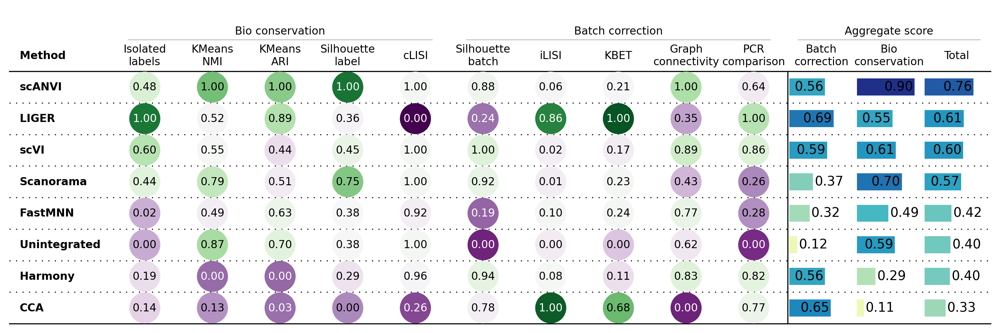

In [72]:
bm.plot_results_table(save_dir="/mnt/disk5/Lanxiang/Human_integrated/integrated/10.29_update/fig/figures")

In [73]:
from rich import print

df_1 = bm.get_results()
print(df_1)
df_1.to_csv('/mnt/disk5/Lanxiang/Human_integrated/integrated/10.29_update/fig/figures/scib_df.csv')

Isolated labels        KMeans NMI        KMeans ARI  \
Embedding                                                            
Unintegrated               0.0          0.874302          0.704175   
Scanorama              0.44246          0.786475          0.507077   
LIGER                      1.0          0.523828          0.889563   
Harmony               0.193171               0.0               0.0   
scVI                  0.600788          0.550373          0.436405   
scANVI                0.483358               1.0               1.0   
CCA                     0.1422          0.125642          0.026366   
FastMNN               0.017405          0.487046          0.632146   
Metric Type   Bio conservation  Bio conservation  Bio conservation   

              Silhouette label             cLISI  Silhouette batch  \
Embedding                                                            
Unintegrated          0.381478          0.999997               0.0   
Scanorama               0.7527               1.0          0.922906   
LIGER                 0.360316               0.0          0.238053   
Harmony               0.290458          0.957301          0.943816   
scVI                   0.44778               1.0               1.0   
scANVI                     1.0               1.0          0.879531   
CCA                        0.0          0.264608          0.784232   
FastMNN               0.383218          0.924524          0.192297   
Metric Type   Bio conservation  Bio conservation  Batch correction   

                         iLISI              KBET Graph connectivity  \
Embedding                                                             
Unintegrated               0.0               0.0           0.619931   
Scanorama             0.006006          0.234031           0.427385   
LIGER                 0.860499               1.0           0.353645   
Harmony               0.081343          0.107767            0.82922   
scVI                   0.01814          0.169329           0.893472   
scANVI                0.059183          0.205166                1.0   
CCA                        1.0          0.679127                0.0   
FastMNN               0.096903          0.240385           0.772948   
Metric Type   Batch correction  Batch correction   Batch correction   

                PCR comparison Batch correction Bio conservation  \
Embedding                                                          
Unintegrated               0.0         0.123986          0.59199   
Scanorama             0.261123          0.37029         0.697742   
LIGER                      1.0         0.690439         0.554741   
Harmony               0.823128         0.557055         0.288186   
scVI                  0.864231         0.589034         0.607069   
scANVI                0.640441         0.556864         0.896672   
CCA                   0.771231         0.646918         0.111763   
FastMNN               0.279156         0.316338         0.488868   
Metric Type   Batch correction  Aggregate score  Aggregate score   

                        Total  
Embedding                      
Unintegrated         0.404789  
Scanorama            0.566761  
LIGER                0.609021  
Harmony              0.395734  
scVI                 0.599855  
scANVI               0.760749  
CCA                  0.325825  
FastMNN              0.419856  
Metric Type   Aggregate score

In [74]:
df_1.transpose()

df_transposed_1 = df_1.transpose()
df_transposed_1.to_csv('/mnt/disk5/Lanxiang/Human_integrated/integrated/10.29_update/fig/figures/scib_df_transposed.csv', index=False)


In [75]:
adata.obs['sample'] = adata.obs['sample'].astype(str)
adata.write_h5ad(filename="/mnt/disk5/Lanxiang/Human_integrated/integrated/10.29_update/scib_human_monkey10.30.h5ad")
